# import

In [2]:
!pip install mat73

In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
import sys
sys.path.append('/content/drive/MyDrive/GTxPython')

ModuleNotFoundError: No module named 'google.colab'

In [1]:
import tensorflow as tf
print(tf.test.is_built_with_cuda())
print(tf.config.list_physical_devices("GPU"))

2025-10-03 12:04:46.833269: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-10-03 12:04:46.901006: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
/home/zhouarth/anaconda3/envs/tf/lib/python3.10/site-packages/google/protobuf/runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.1 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
/home/zhouarth/anac

True
[]


W0000 00:00:1759507489.021399   78454 gpu_device.cc:2342] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


In [2]:
import scipy.io as sio
import mat73
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import keras
import tensorflow as tf
from keras.saving import register_keras_serializable
import sys
from preprocess import *

In [3]:
print("Python:", sys.executable)
print("TF version:", tf.__version__)
print("CUDA built with:", tf.sysconfig.get_build_info().get("cuda_version"))
print("cuDNN built with:", tf.sysconfig.get_build_info().get("cudnn_version"))

Python: /home/zhouarth/anaconda3/envs/tf/bin/python
TF version: 2.20.0
CUDA built with: 12.5.1
cuDNN built with: 9


In [5]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        print(gpus)
        tf.config.set_visible_devices(gpus[0], 'GPU')
        tf.config.experimental.set_memory_growth(gpus[0], True)
    except RuntimeError as e:
        print(e)

In [4]:
from tensorflow.python.client import device_lib

def get_available_devices():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos]

print(get_available_devices())

['/device:CPU:0']


W0000 00:00:1759507492.208703   78454 gpu_device.cc:2342] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


# model

## unzip model

In [34]:
# !tar -xvzf /content/drive/MyDrive/GTxPython/new_ckpt_unet/hikaru_2d_pad10/model.tar.gz -C /content/drive/MyDrive/GTxPython/new_ckpt_unet/hikaru_2d_pad10/

tar: Ignoring unknown extended header keyword 'LIBARCHIVE.creationtime'
loss.log
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.creationtime'
model.keras


## test model

In [6]:
@register_keras_serializable(package="metrics_losses")
class TumorMAE(tf.keras.metrics.Metric):
    def __init__(self, depth_padding=10.0, name="tumor_mae", **kwargs):
        super().__init__(name=name, **kwargs)
        self.depth_padding = depth_padding
        self.total = self.add_weight(name="total", initializer="zeros")
        self.count = self.add_weight(name="count", initializer="zeros")

    def update_state(self, y_true, y_pred, sample_weight=None):
        mask = tf.not_equal(y_true, self.depth_padding)
        err  = tf.abs(y_true - y_pred)
        masked_err = tf.boolean_mask(err, mask)
        value = tf.cond(
            tf.size(masked_err) > 0,
            lambda: tf.reduce_mean(masked_err),
            lambda: tf.constant(0.0)
        )
        self.total.assign_add(value)
        self.count.assign_add(1.0)

    def result(self):
        return self.total / self.count

In [7]:
def test_load_model(model_path):
    model = keras.models.load_model(model_path, safe_mode=True)

    input_1 = tf.constant(np.ones((1, 101, 101, 2), dtype=np.float32))
    input_2 = tf.constant(np.ones((1, 101, 101, 6, 1), dtype=np.float32))

    output = model([input_1, input_2], training=False)

    print(output[0].shape)
    print(output[1].shape)

In [8]:
model_path_local = "./model_params/hikaru_dropout_2DnoiseDTTBR/model.keras"
model_path_drive = "/content/drive/MyDrive/GTxPython/new_ckpt_unet/hikaru_2d_pad20/model.keras"

test_load_model(model_path_local)

(1, 101, 101)
(1, 101, 101)


# utils

In [9]:
def draw_pred(gt_depth, pred_depth):
  fig, ax = plt.subplots(1, 3, figsize=(10, 5))
  v_min = min(np.min(gt_depth), np.min(pred_depth))
  v_max = max(np.max(gt_depth), np.max(pred_depth))
  im0 = ax[0].imshow(gt_depth, cmap='viridis', vmin=v_min, vmax=v_max)
  ax[0].set_title('Ground Truth')
  ax[1].imshow(pred_depth, cmap='viridis', vmin=v_min, vmax=v_max)
  ax[1].set_title('Prediction')
  im2 = ax[2].imshow(gt_depth - pred_depth, cmap='Purples')
  ax[2].set_title('Difference')
  cbar = fig.colorbar(im0, ax=ax[0:2], orientation='vertical')
  cbar.set_label('Depth')
  cbar_err = fig.colorbar(im2, ax=ax[2], orientation='vertical')
  cbar_err.set_label('Error')
  plt.show()

# predict

## on simulated data

In [29]:
scale_params = {
    'fluorescence': 10e4,
    'mu_a': 10,
    'mu_s': 1,
    'depth': 1,
    'concentration_fluor': 1,
    'reflectance': 1,
}
file_path_drive = "/content/drive/MyDrive/GTxPython/data/finalized/ts_2d_10000_original_TBR.mat"
file_path_local = "./data/ts_2d_10000_original_TBR.mat"
test_hikaru_csh = "/mnt/c/Users/Arthur Zhou/UHN/GTx - DalyShare/ImageData/DL/20221220_AWS/SubmarineTestingDataAll/20250108_1000_CSH_PpIX/DL_nImages1000.mat"

test_data = load_data(test_hikaru_csh, scale_params, 888, 0)


Normalize: 0
FFFFF: [(1.8098149e-06, 0.0009014229), (1.6067189e-07, 0.0006274206), (3.4686018e-08, 0.00043985285), (1.3818778e-08, 0.00032520702), (1.0965559e-08, 0.00024258412), (8.841042e-09, 0.00018760224)]
OOOOO: [(0.0034044283, 0.010552231), (0.9502248, 1.0333169)]
You are not normalizing the data
You are not normalizing the data
You are not normalizing the data


In [30]:
def try_pred(model, test_data, draw=False, depth_padding=10.0, device='cpu', batch=1):
    if device == "auto":
        device_str = "/GPU:0" if tf.config.list_physical_devices("GPU") else "/CPU:0"
    elif device.lower() == "gpu":
        device_str = "/GPU:0"
    elif device.lower() == "cpu":
        device_str = "/CPU:0"
    else:
        device_str = device

    tt_data = test_data['test']
    N = len(tt_data["depth"])
    idx_all = list(range(0, N))

    acc_err = 0
    acc_count = 0

    for b_start in tqdm(range(0, len(idx_all), batch)):
        b_end = min(b_start + batch, len(idx_all))
        batch_idx = idx_all[b_start:b_end]

        fl = tt_data['fluorescence'][batch_idx, ...]
        mu_a = tt_data['mu_a'][batch_idx, ...]
        mu_s = tt_data['mu_s'][batch_idx, ...]
        op = np.stack([mu_a, mu_s], axis=-1)
        conc_fluor = tt_data['concentration_fluor'][batch_idx, ...]
        reflectance = tt_data['reflectance'][batch_idx, ...]
        depth = tt_data['depth'][batch_idx, ...]
        depth[depth==0] = depth_padding


        input1 = tf.convert_to_tensor(op, dtype=tf.float32)
        input2 = tf.convert_to_tensor(fl, dtype=tf.float32)

        outputs = model([input1, input2], training=False)
        pred_conc = outputs[0].numpy()
        pred_depth = outputs[1].numpy()

        for k in range(len(batch_idx)):
            idx = batch_idx[k]
            gt = depth[k].copy()
            p = pred_depth[k].copy()
            max_gt = np.max(gt[gt!=depth_padding])

            if max_gt < depth_padding:
                p[p>max_gt]=0
            else:
                p[(p >= depth_padding-0.5) & (p <= depth_padding+0.5)]=0
            gt[gt==depth_padding]=0
            draw_pred(gt, p) if draw else None

            difference_map = np.abs(gt - p)
            mean_nonBG = np.mean(difference_map[difference_map != 0])
            print(f"Mean difference: {mean_nonBG}") if draw else None

            acc_err += np.sum(difference_map[difference_map != 0])
            acc_count += (difference_map != 0).sum()

    return acc_err / acc_count
#

  0%|          | 0/13 [00:00<?, ?it/s]

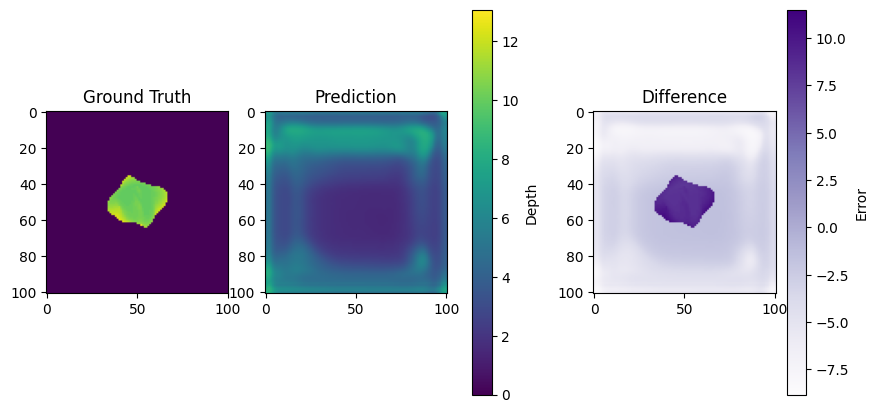

Mean difference: 4.405662536621094


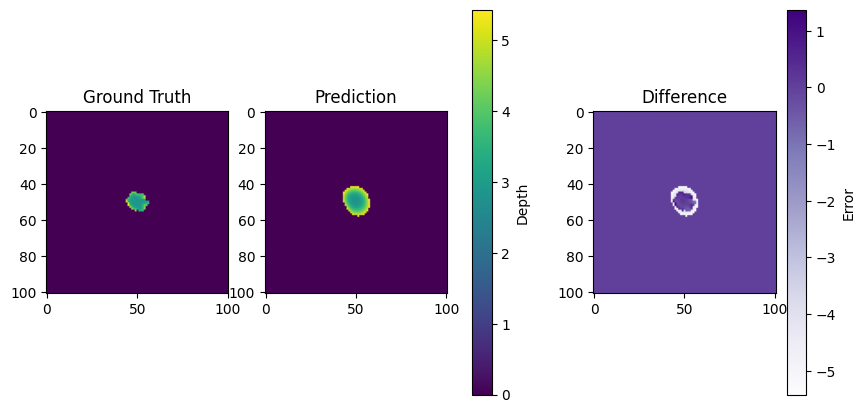

Mean difference: 2.4570350646972656


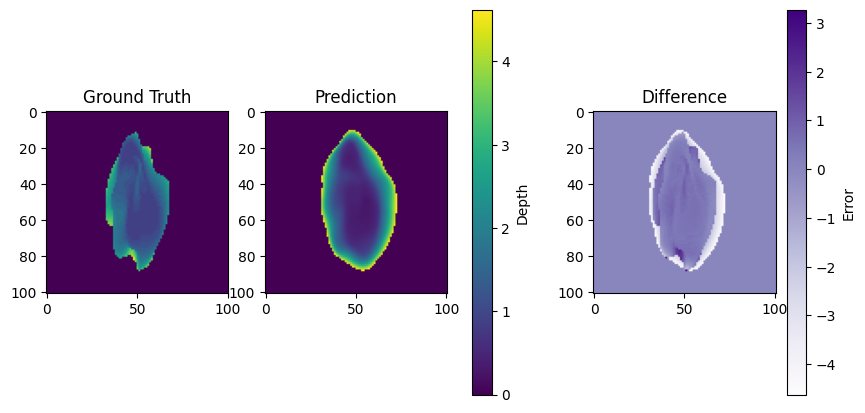

Mean difference: 1.1495336294174194


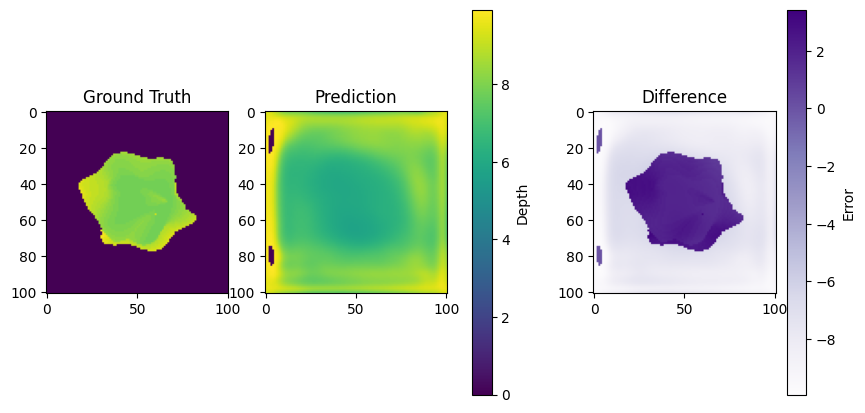

Mean difference: 6.628996849060059


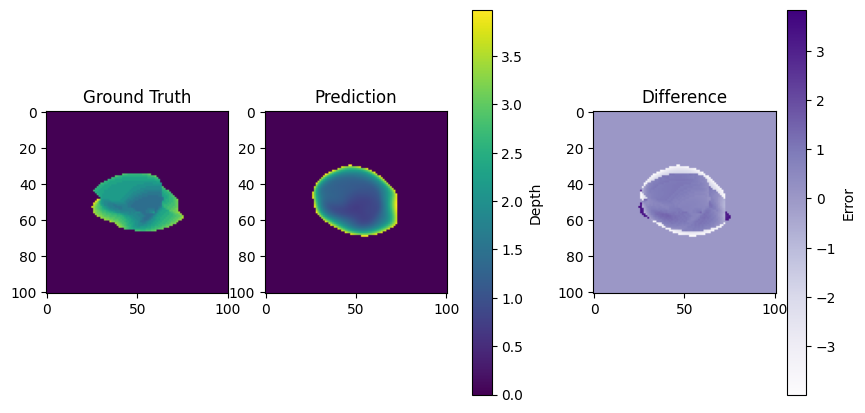

Mean difference: 1.1910161972045898


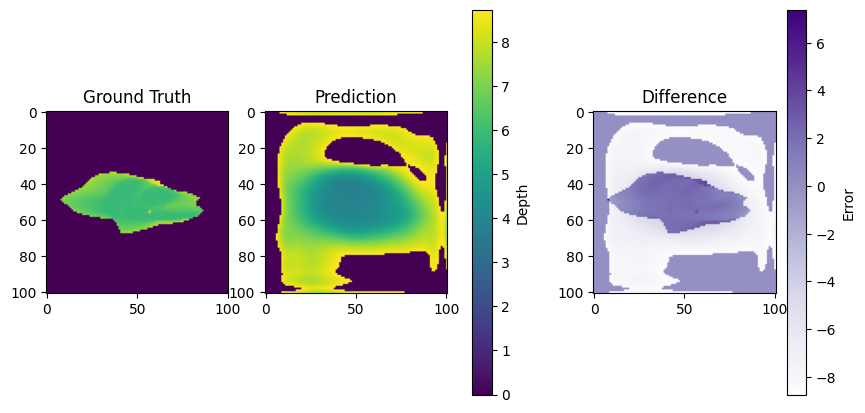

Mean difference: 6.235456943511963


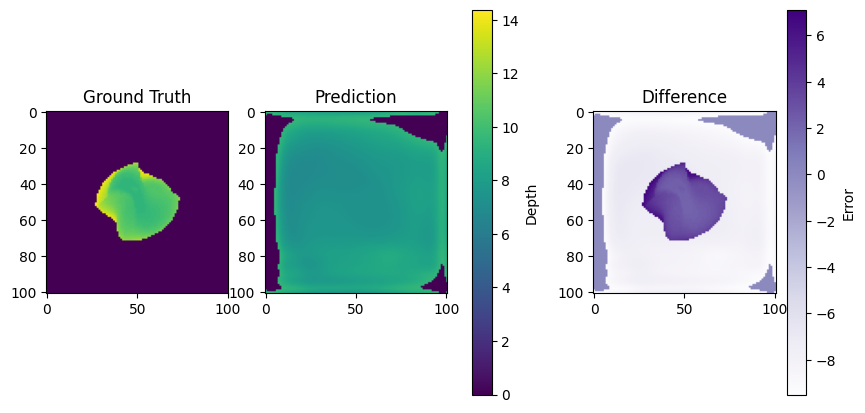

Mean difference: 7.444385051727295


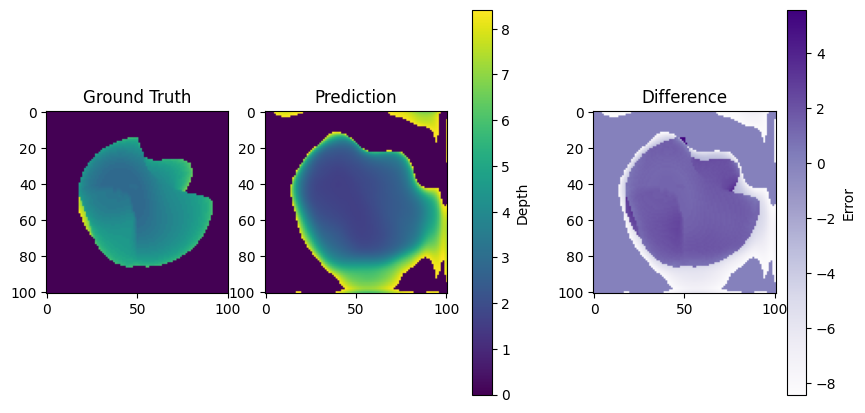

  8%|▊         | 1/13 [00:03<00:36,  3.08s/it]

Mean difference: 3.334627628326416


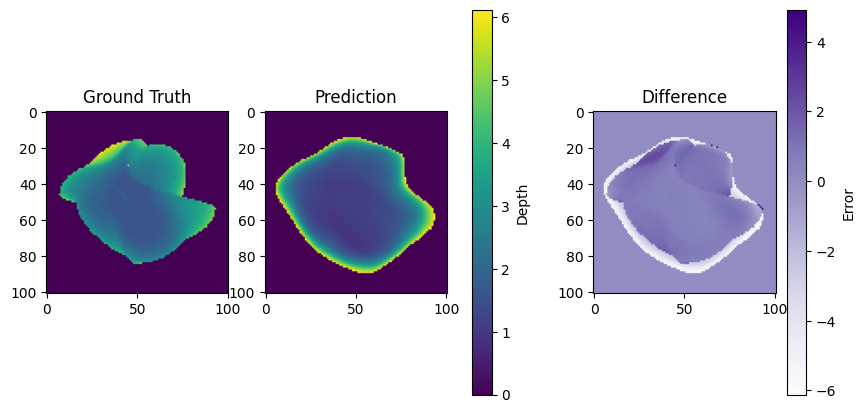

Mean difference: 1.4254833459854126


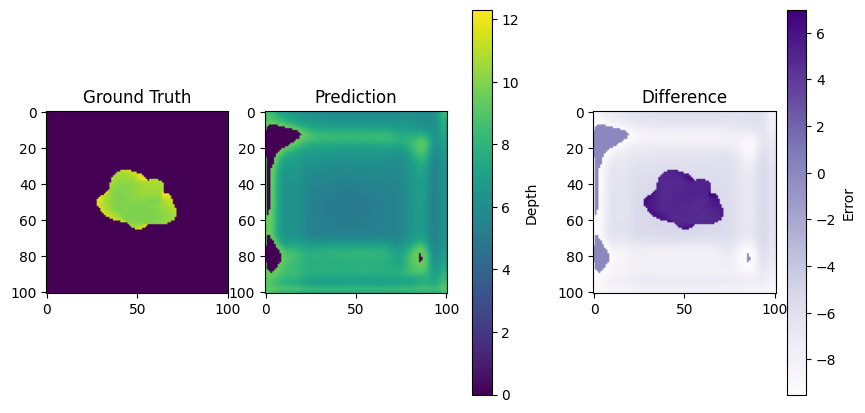

Mean difference: 6.80338191986084


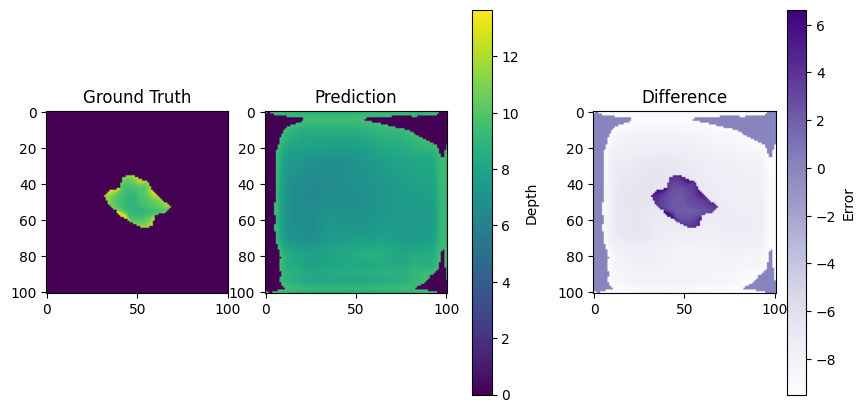

Mean difference: 7.705585479736328


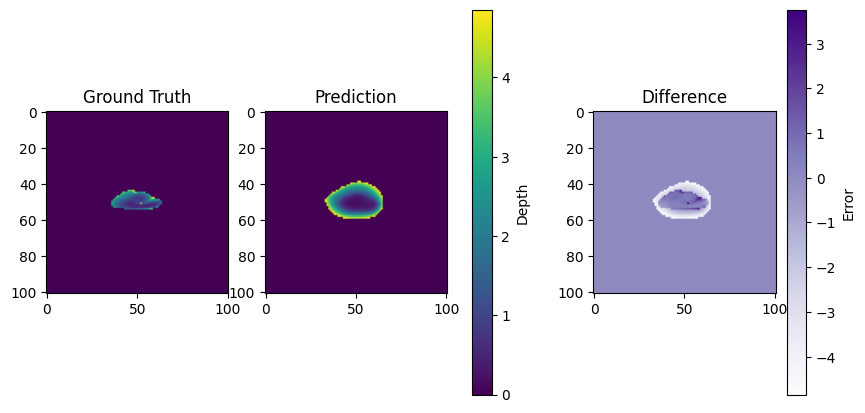

Mean difference: 2.0585038661956787


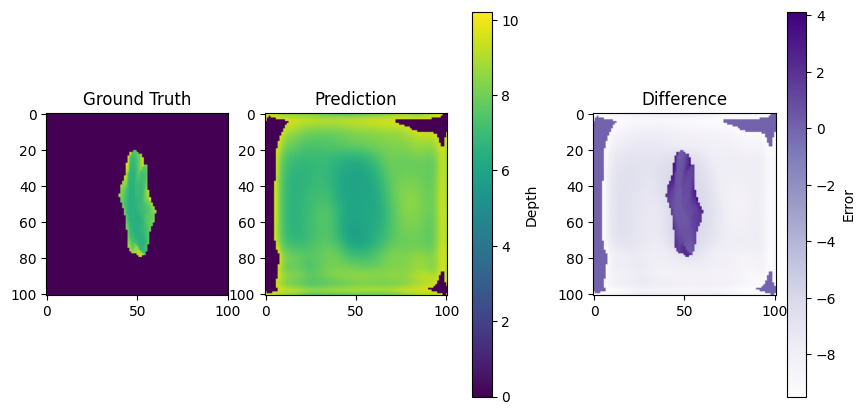

Mean difference: 7.368171215057373


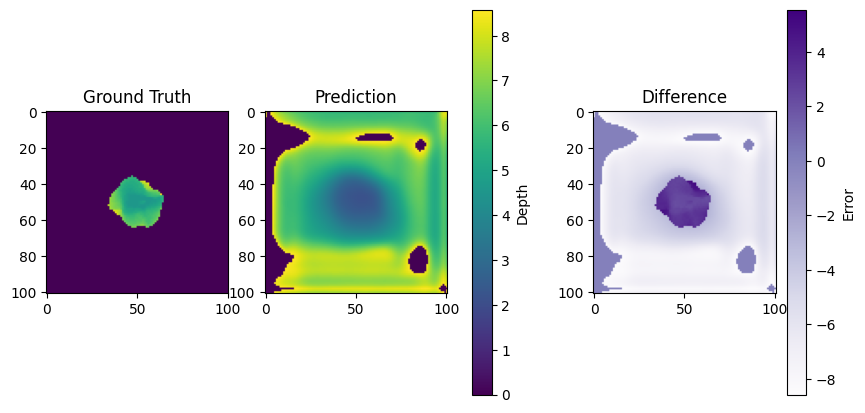

Mean difference: 6.182034492492676


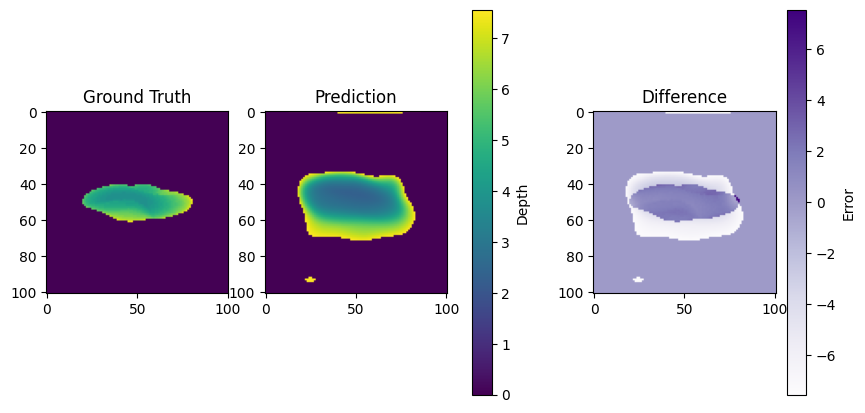

Mean difference: 4.189339637756348


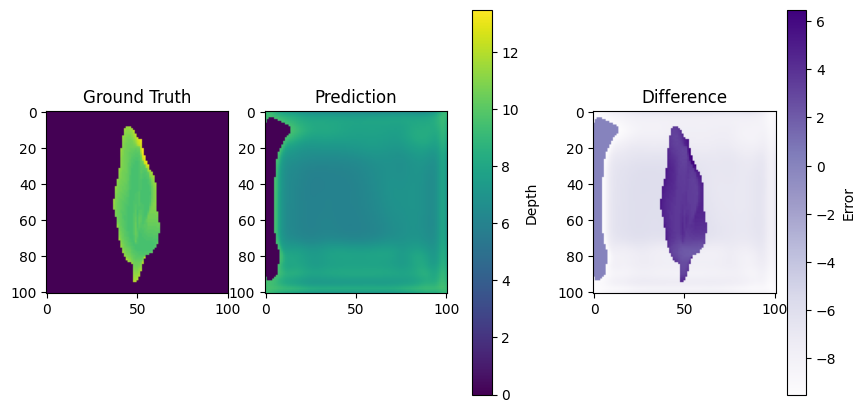

 15%|█▌        | 2/13 [00:05<00:30,  2.73s/it]

Mean difference: 6.8214898109436035


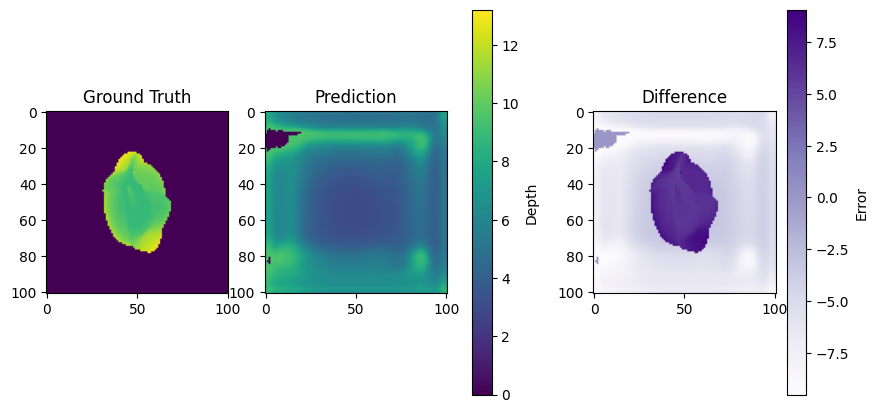

Mean difference: 6.0515899658203125


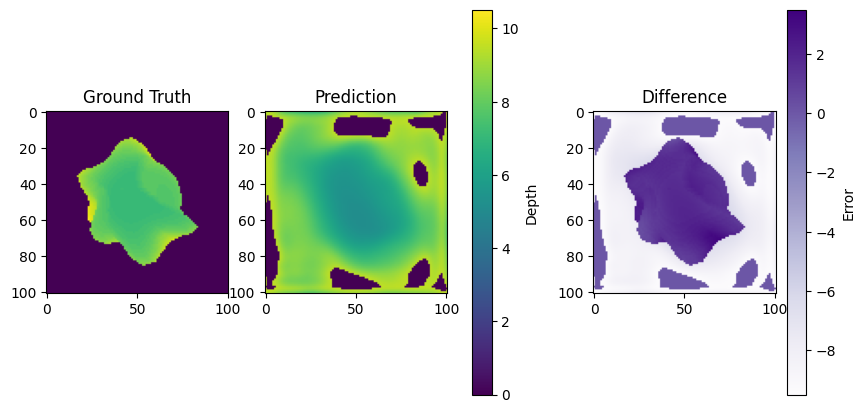

Mean difference: 6.37195348739624


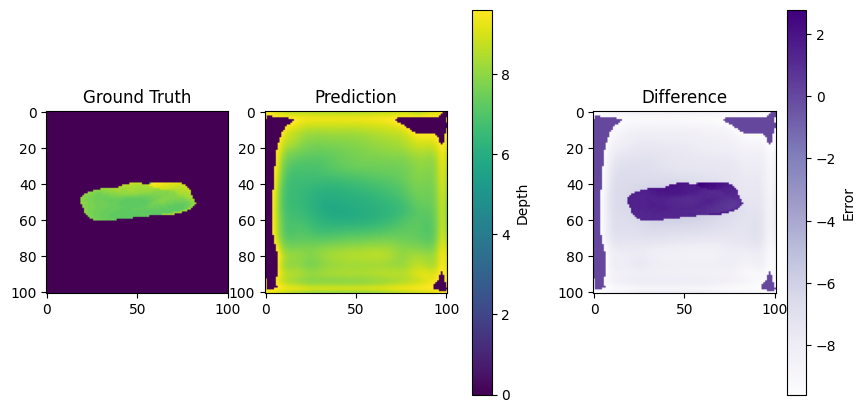

Mean difference: 7.263937950134277


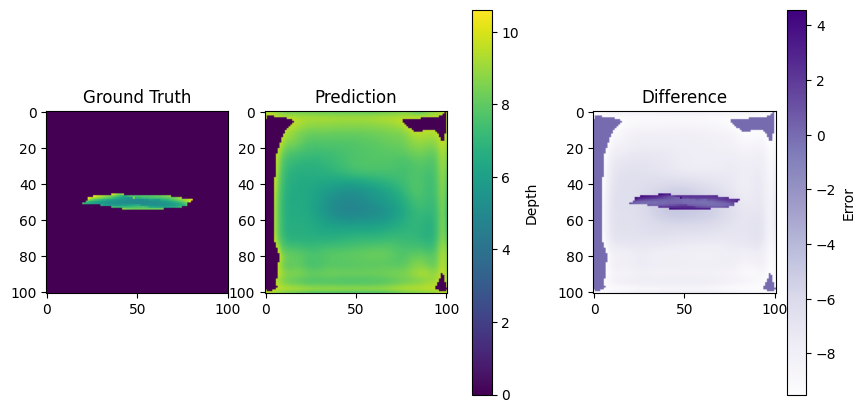

Mean difference: 7.408585548400879


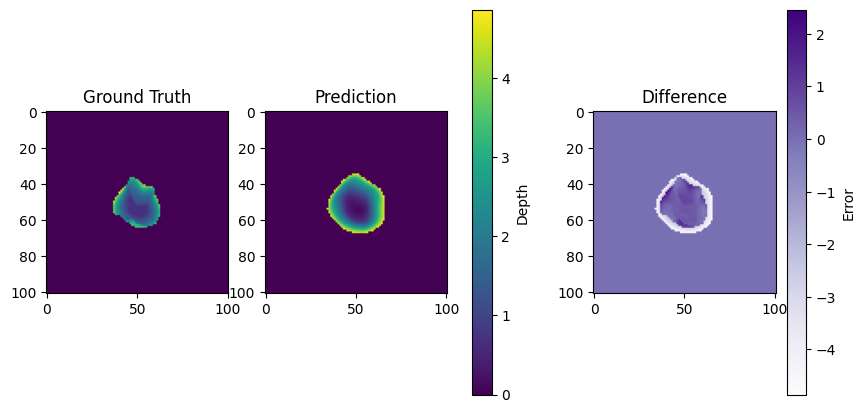

Mean difference: 1.5956997871398926


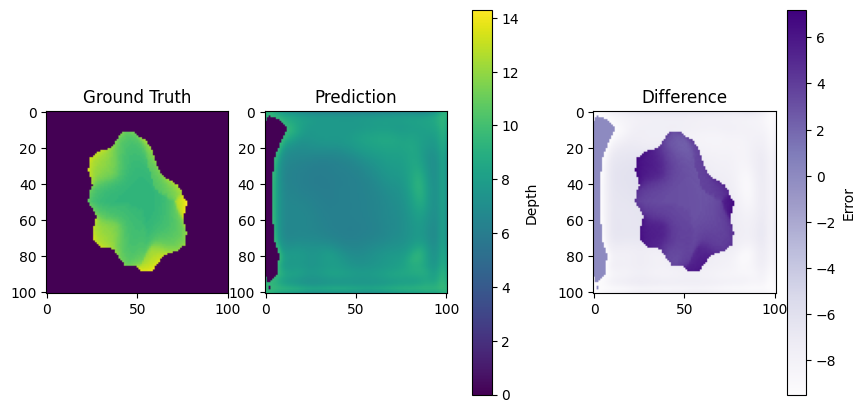

Mean difference: 6.647927761077881


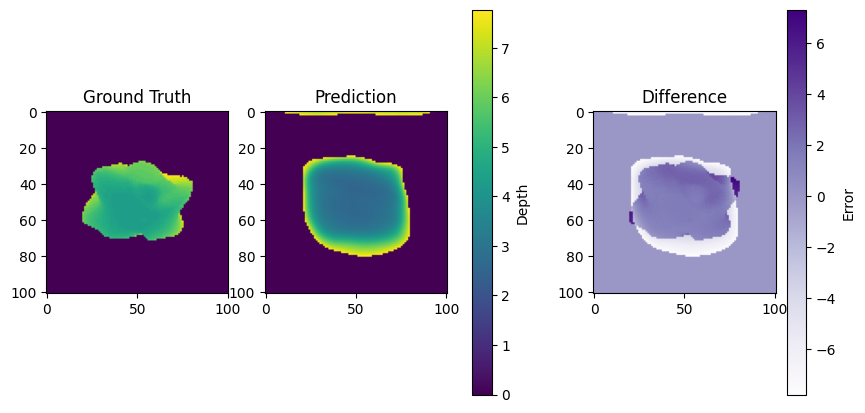

Mean difference: 3.399881362915039


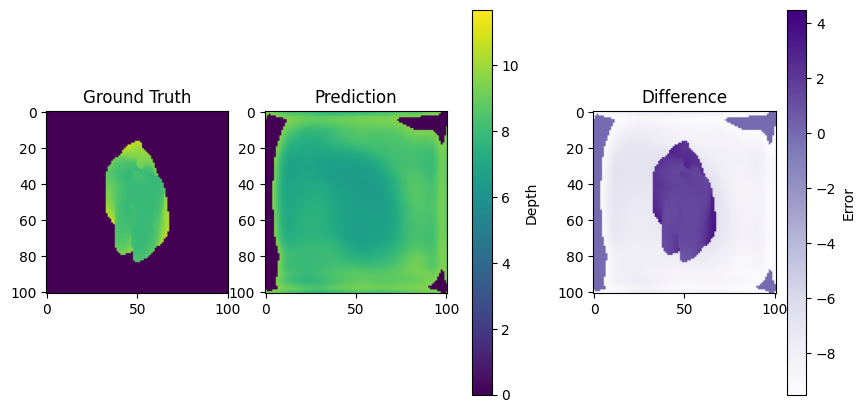

 23%|██▎       | 3/13 [00:08<00:26,  2.67s/it]

Mean difference: 6.981292247772217


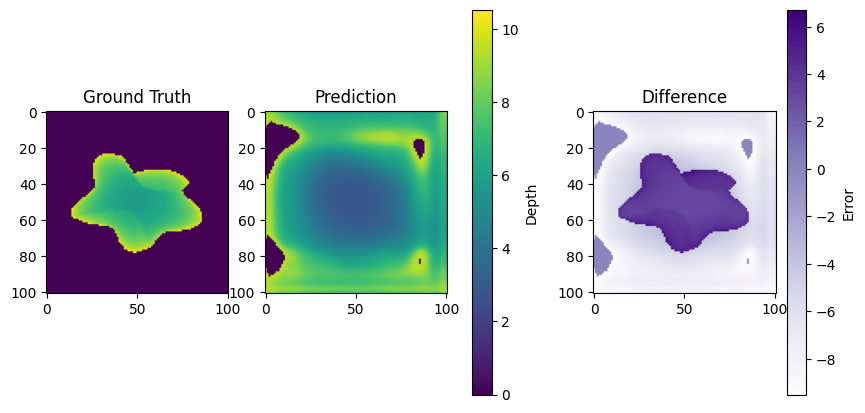

Mean difference: 6.201666355133057


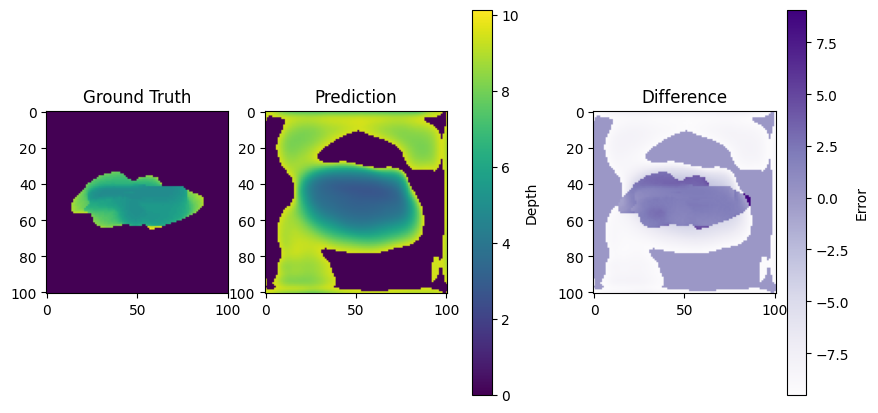

Mean difference: 6.848395824432373


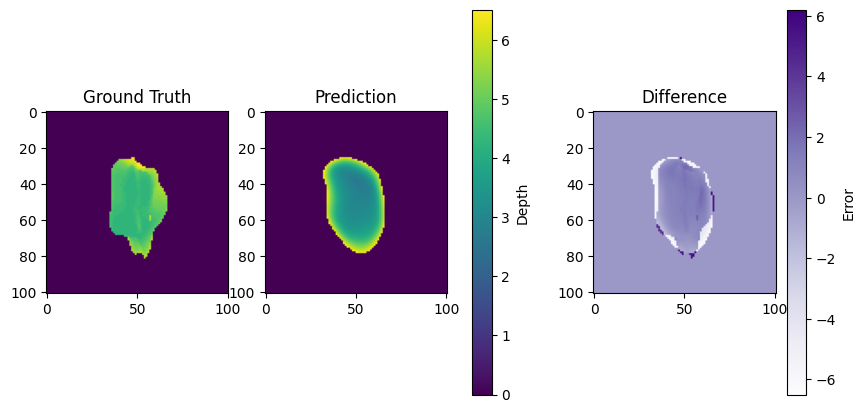

Mean difference: 1.7519035339355469


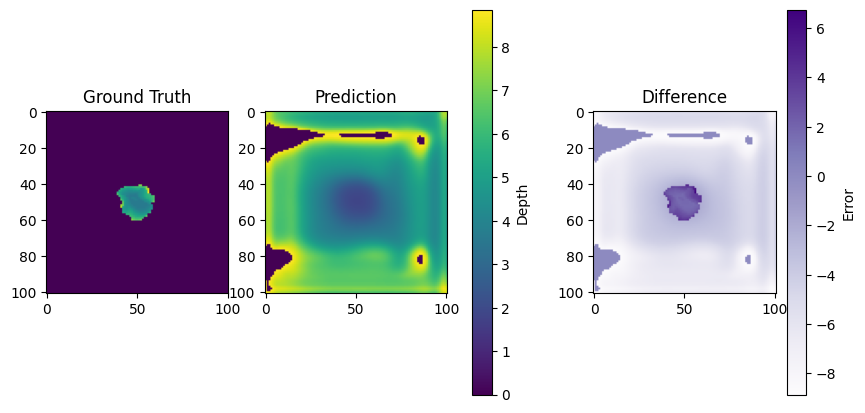

Mean difference: 5.57925271987915


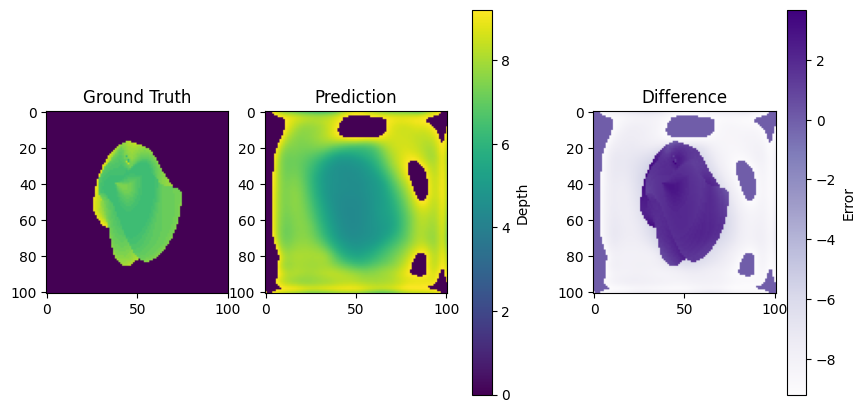

Mean difference: 6.329750061035156


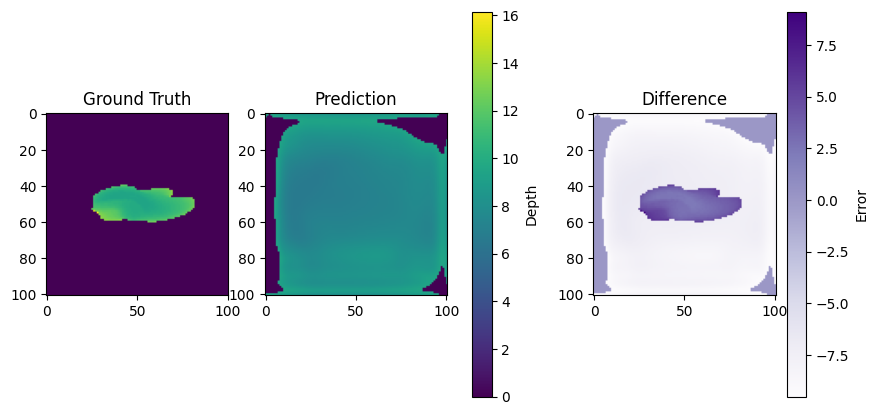

Mean difference: 7.6174397468566895


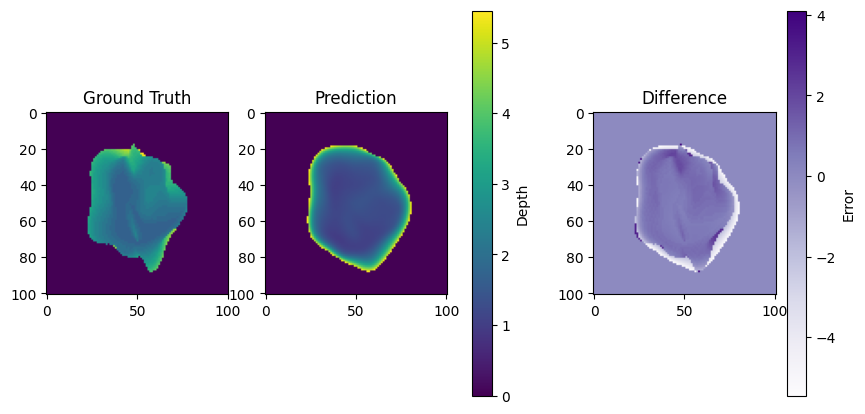

Mean difference: 1.2174928188323975


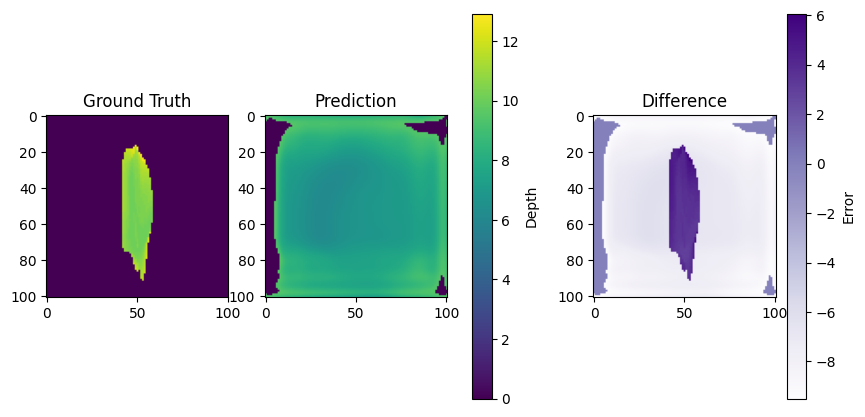

 31%|███       | 4/13 [00:10<00:23,  2.62s/it]

Mean difference: 7.381033897399902


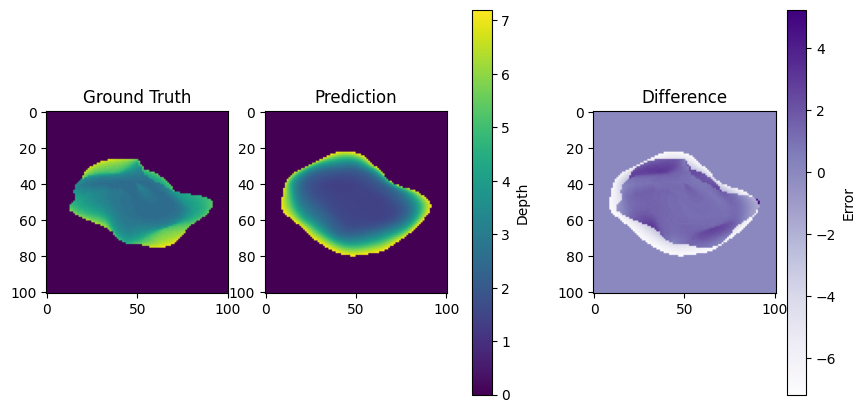

Mean difference: 2.3502614498138428


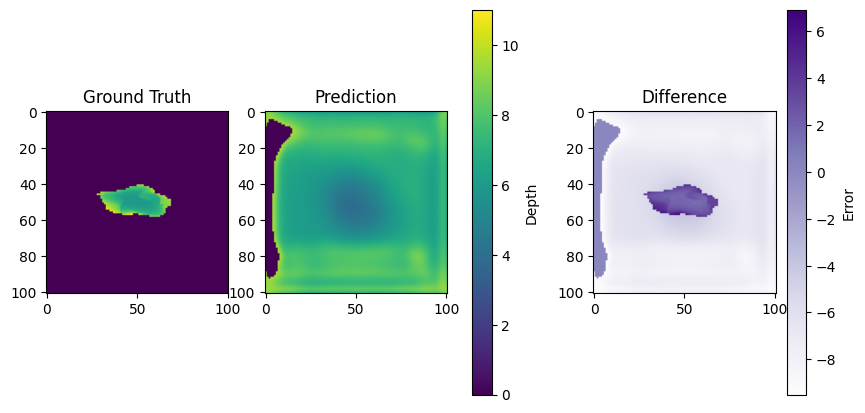

Mean difference: 6.882584095001221


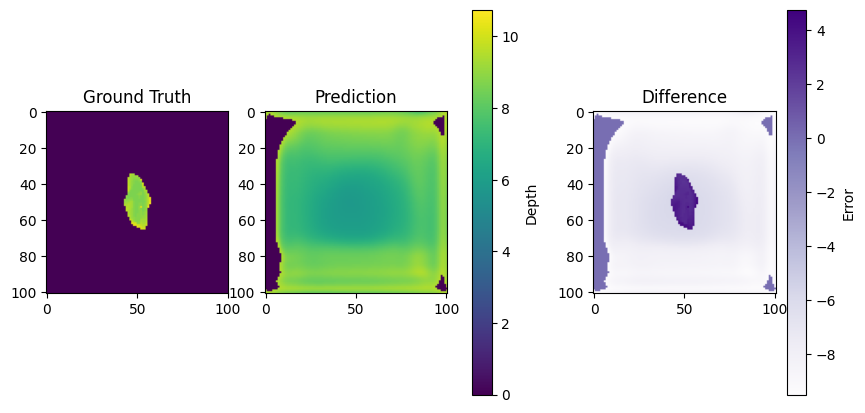

Mean difference: 7.79625940322876


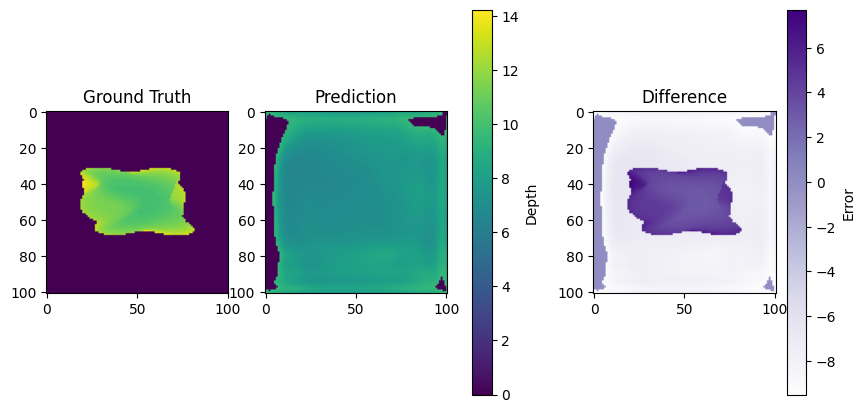

Mean difference: 7.153034210205078


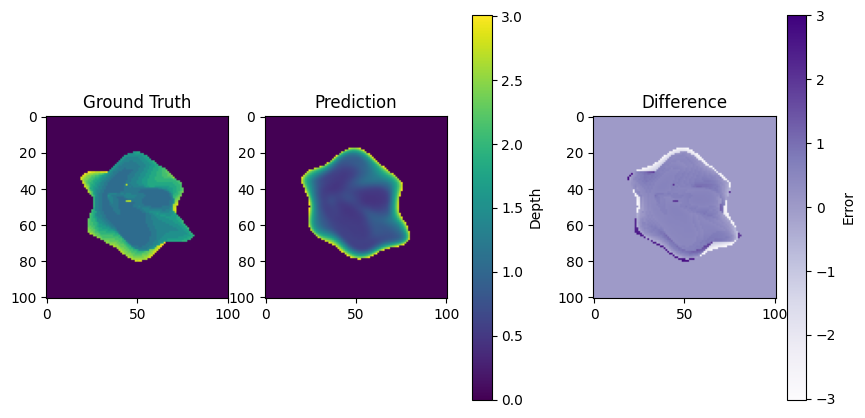

Mean difference: 0.7090745568275452


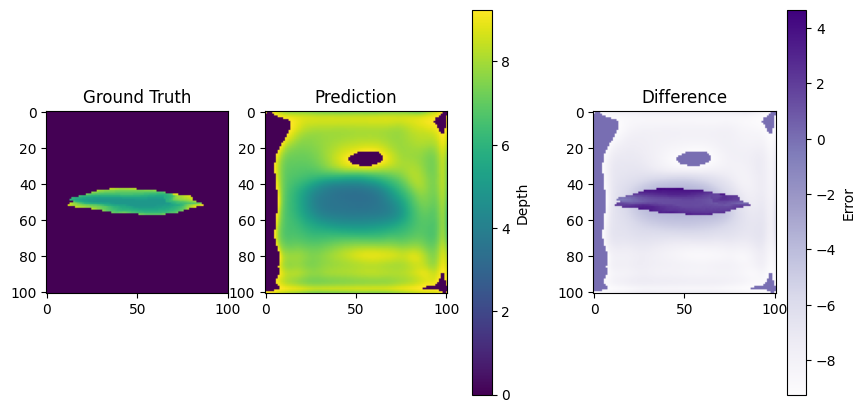

Mean difference: 7.038105010986328


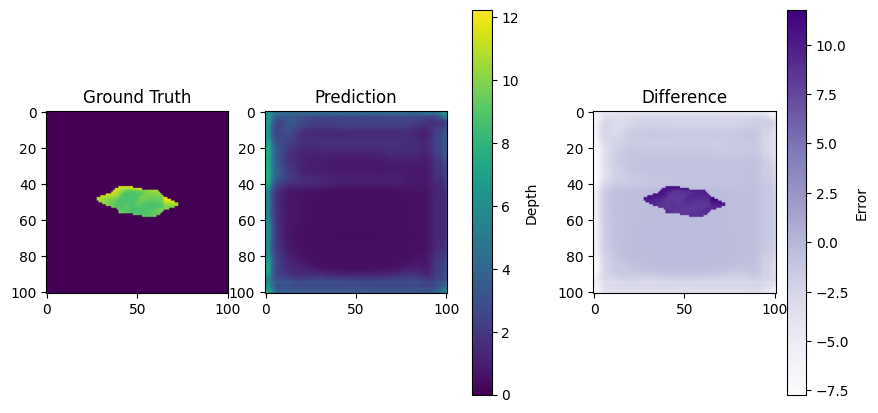

Mean difference: 2.001585006713867


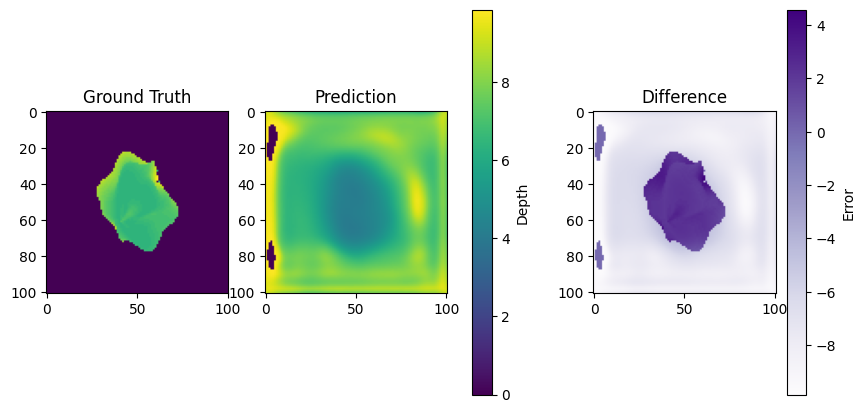

 38%|███▊      | 5/13 [00:13<00:20,  2.56s/it]

Mean difference: 6.760824203491211


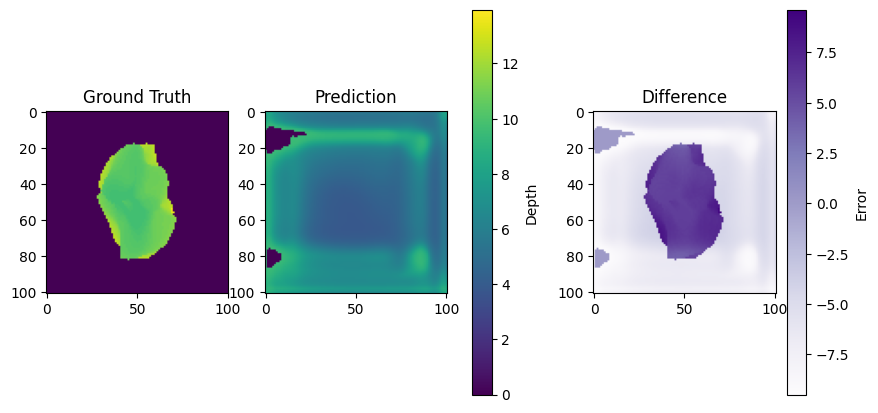

Mean difference: 6.45194673538208


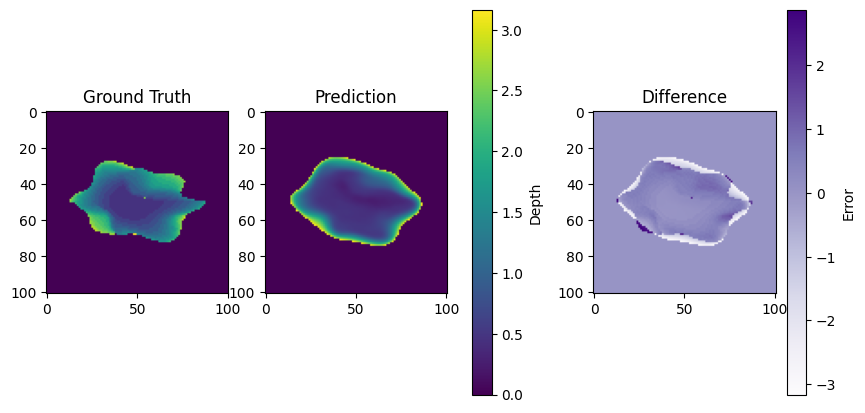

Mean difference: 0.6883341670036316


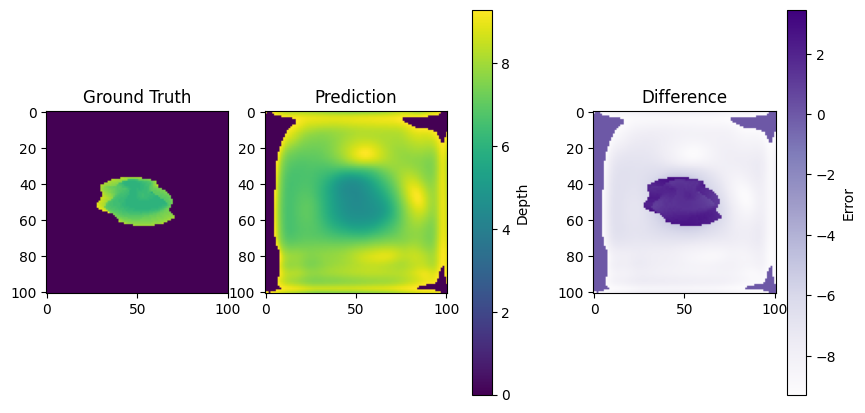

Mean difference: 7.276242733001709


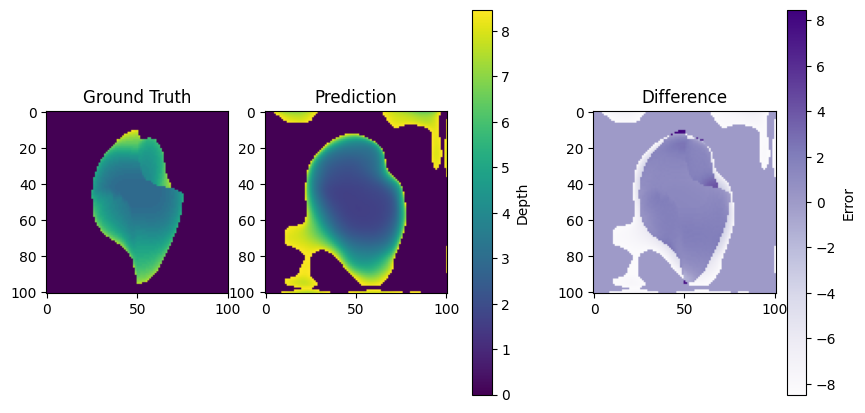

Mean difference: 3.8060390949249268


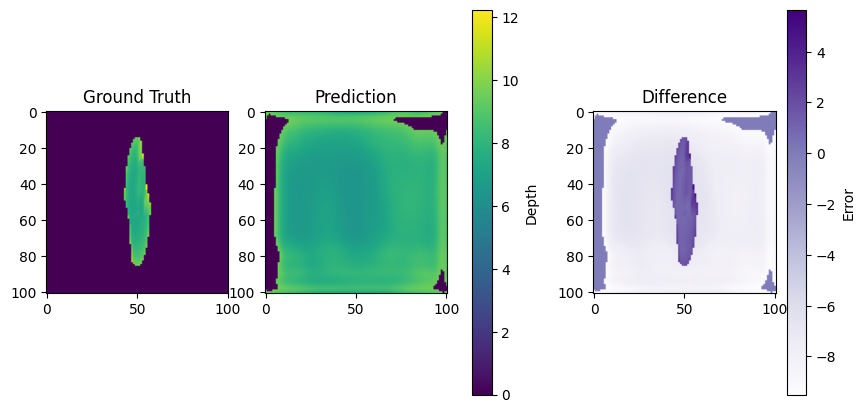

Mean difference: 7.365235805511475


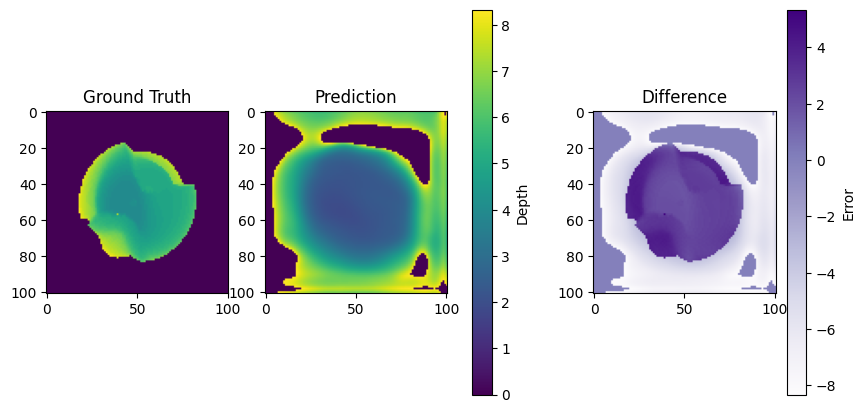

Mean difference: 4.993457317352295


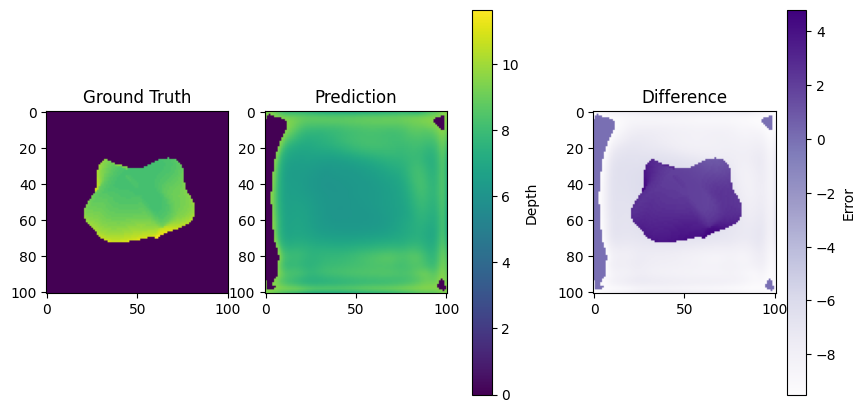

Mean difference: 6.688314914703369


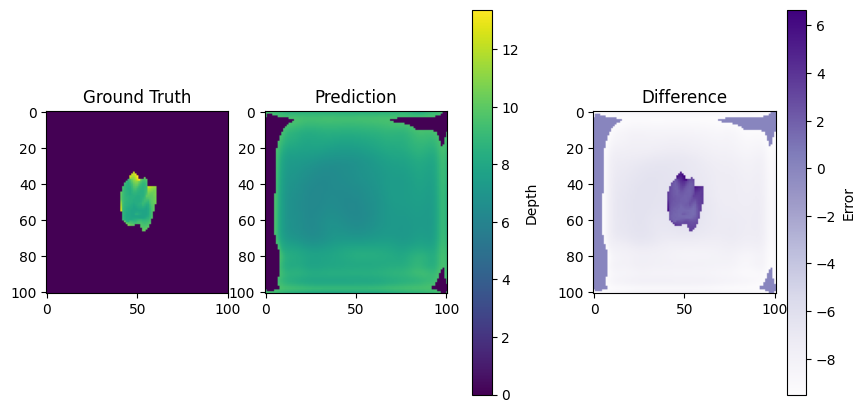

 46%|████▌     | 6/13 [00:15<00:18,  2.62s/it]

Mean difference: 7.6285481452941895


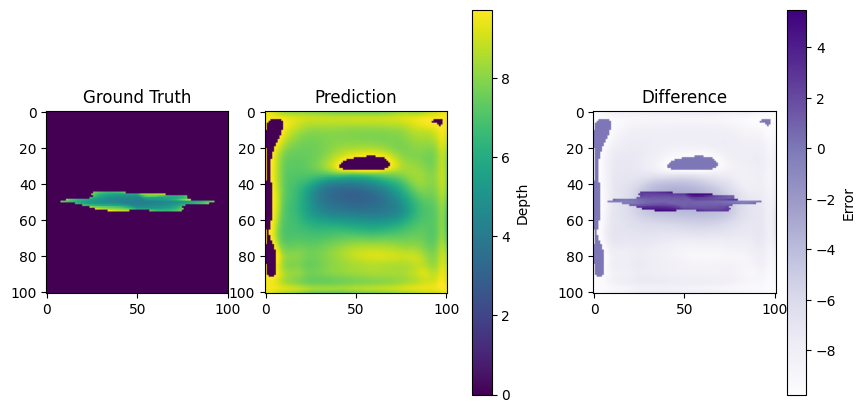

Mean difference: 7.43384313583374


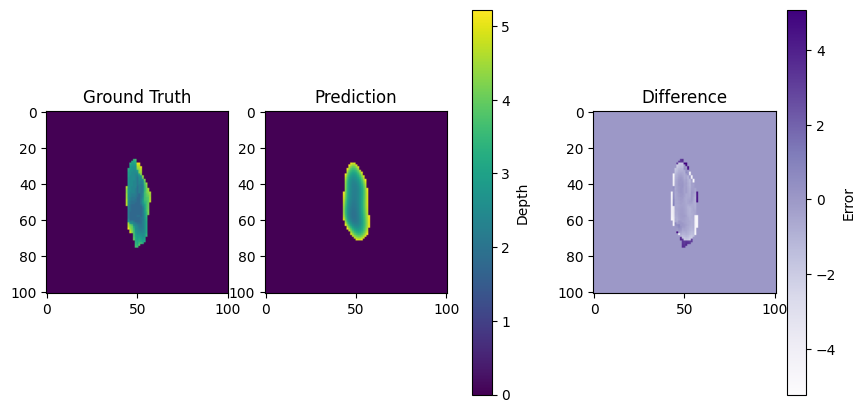

Mean difference: 1.2565022706985474


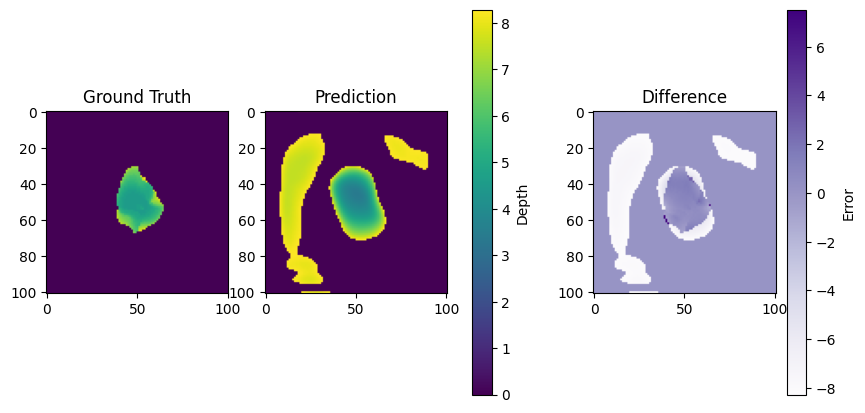

Mean difference: 5.944685459136963


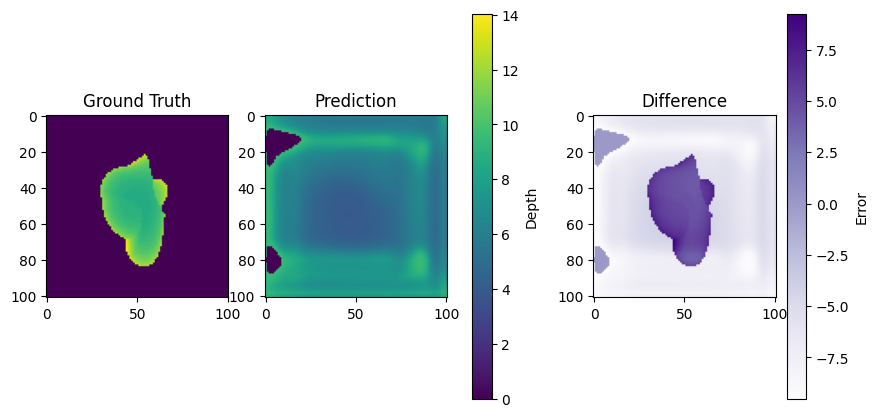

Mean difference: 6.514184951782227


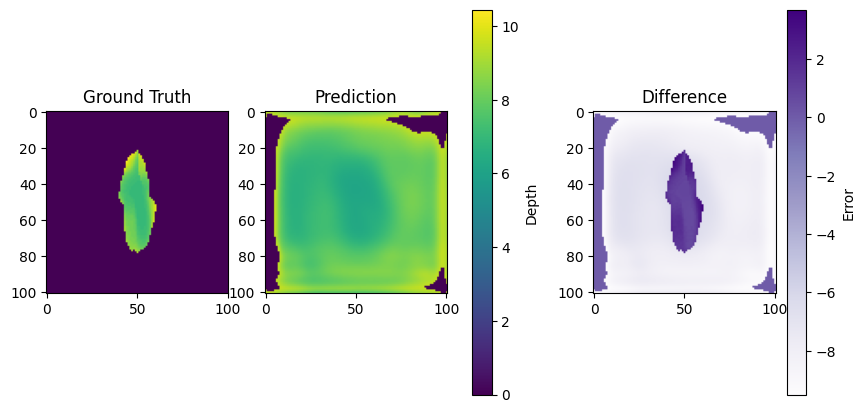

Mean difference: 7.4238996505737305


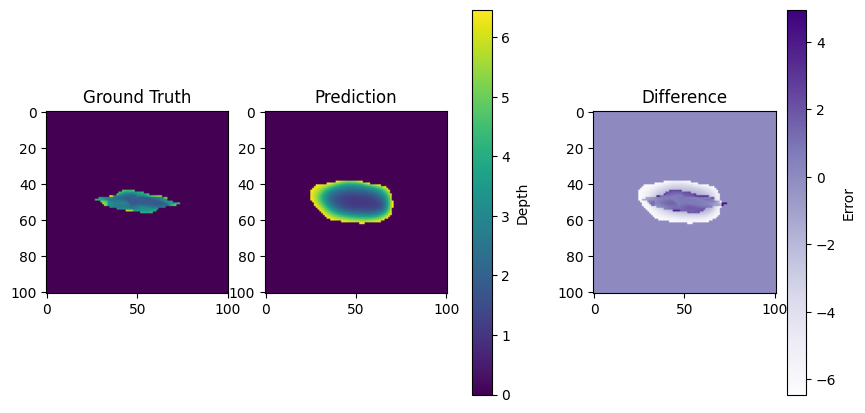

Mean difference: 3.1805670261383057


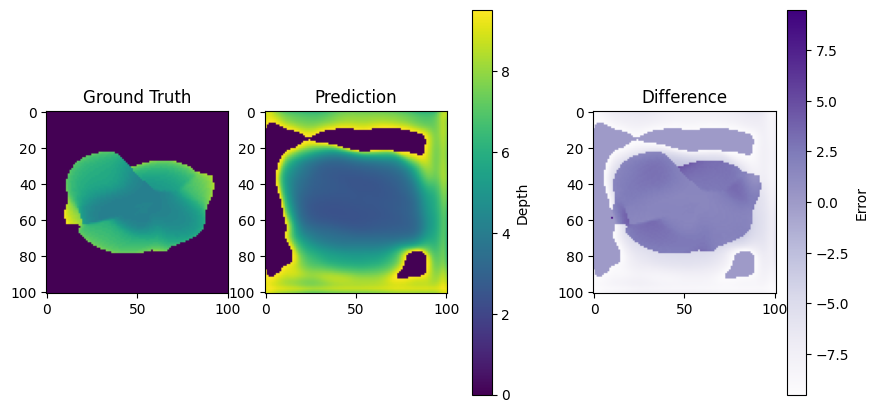

Mean difference: 5.274620532989502


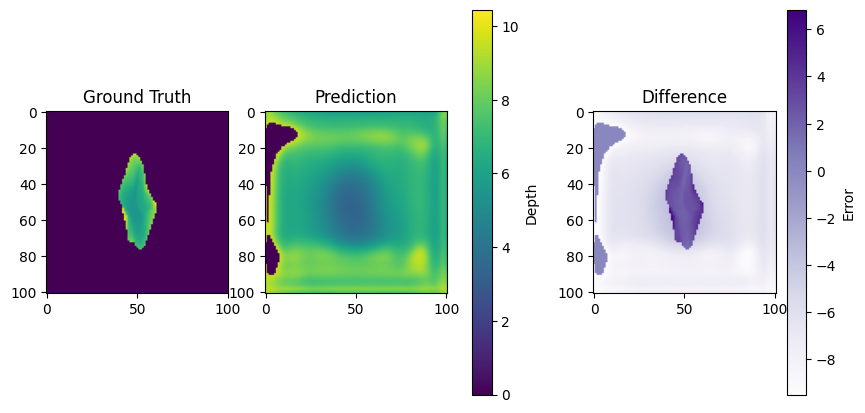

 54%|█████▍    | 7/13 [00:18<00:15,  2.62s/it]

Mean difference: 6.714240074157715


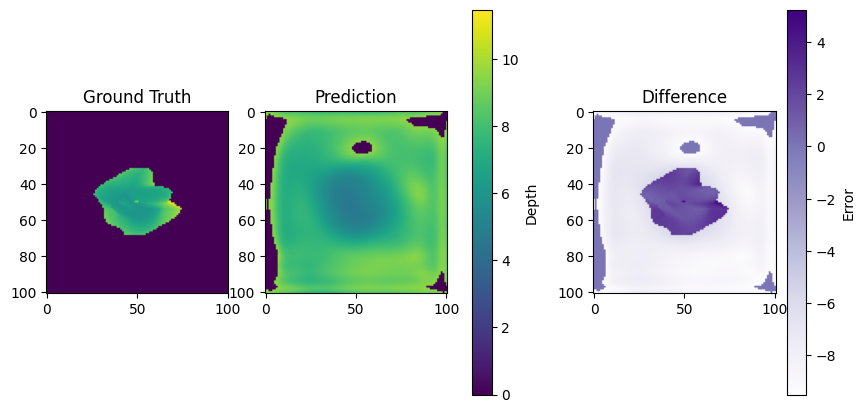

Mean difference: 7.388421058654785


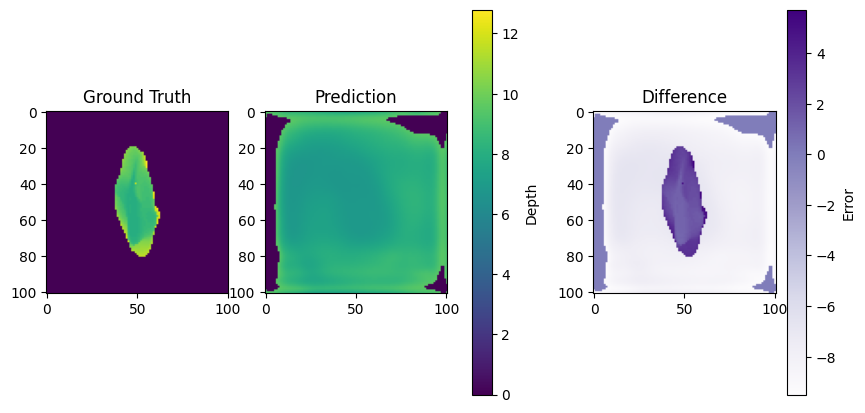

Mean difference: 7.397003650665283


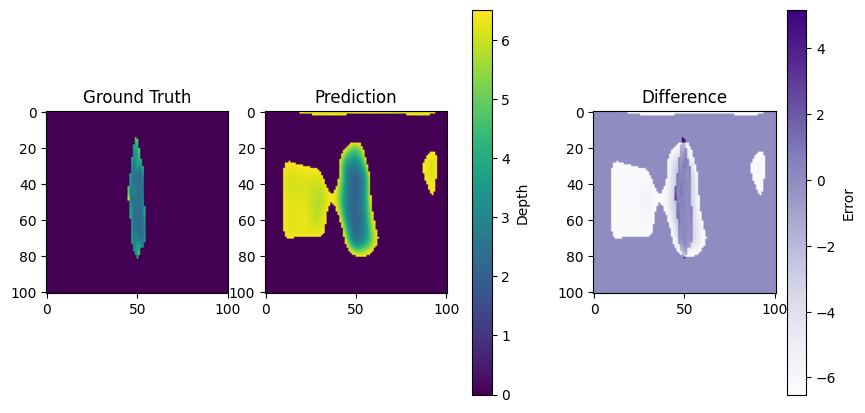

Mean difference: 4.765668869018555


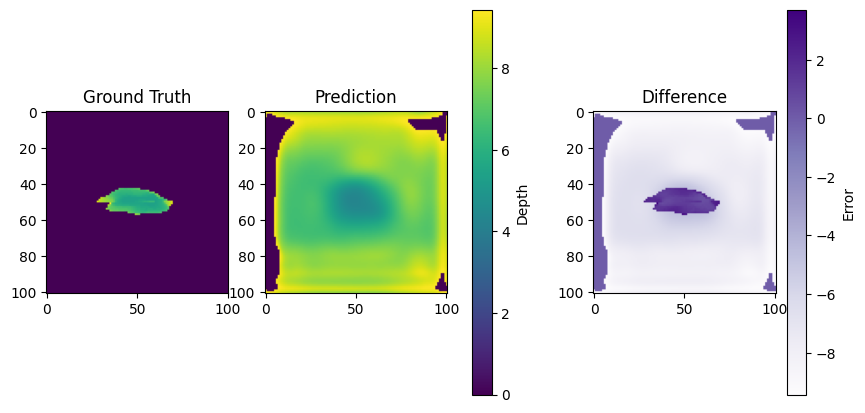

Mean difference: 7.438125133514404


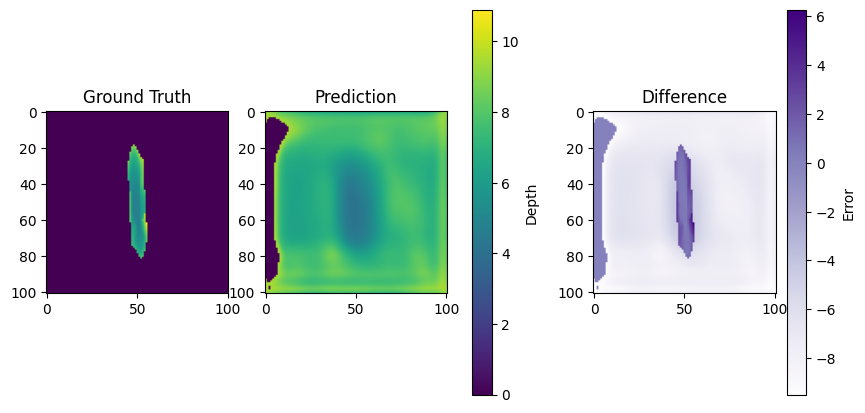

Mean difference: 7.04556941986084


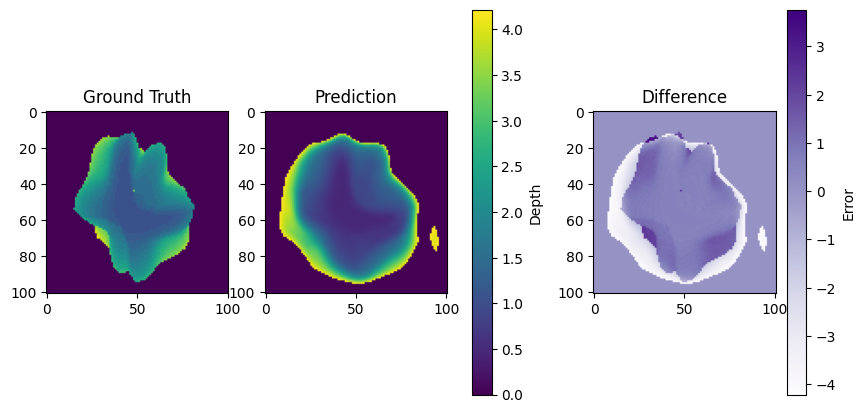

Mean difference: 1.4735733270645142


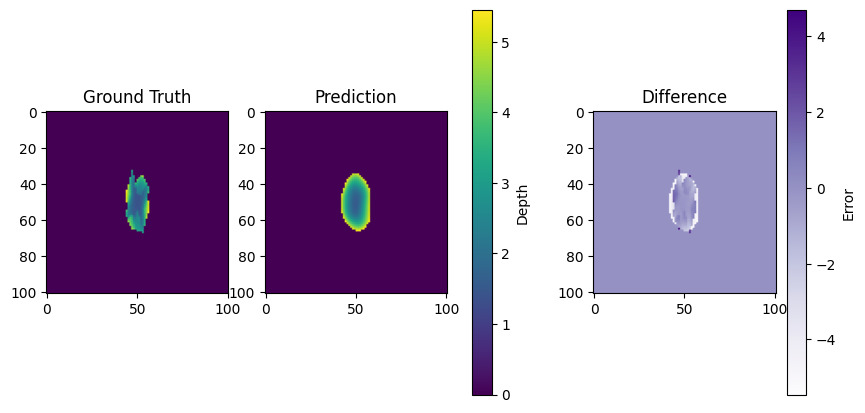

Mean difference: 1.573435664176941


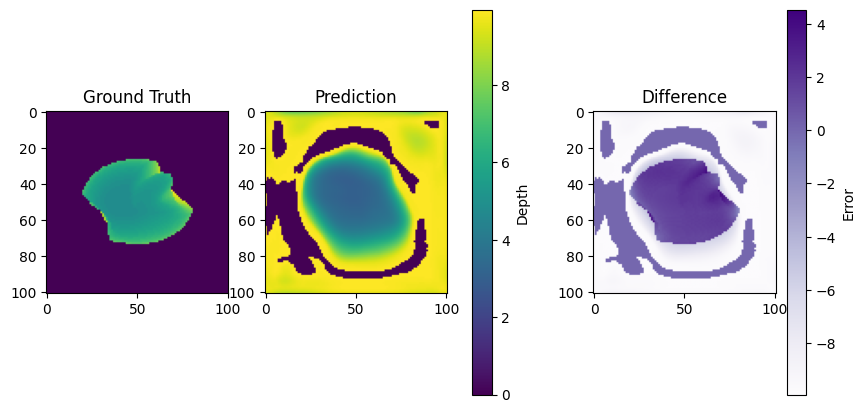

 62%|██████▏   | 8/13 [00:21<00:13,  2.75s/it]

Mean difference: 7.5131025314331055


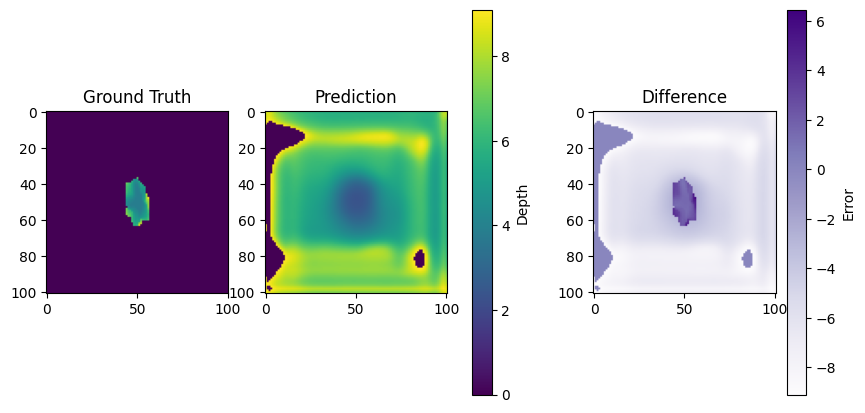

Mean difference: 6.335005760192871


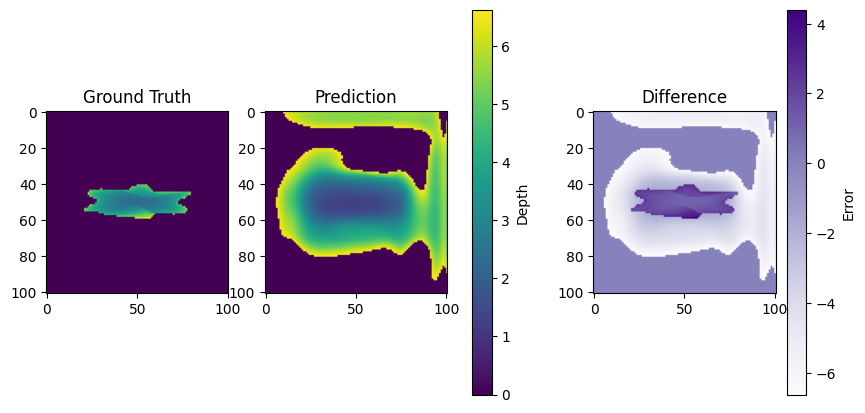

Mean difference: 4.433170318603516


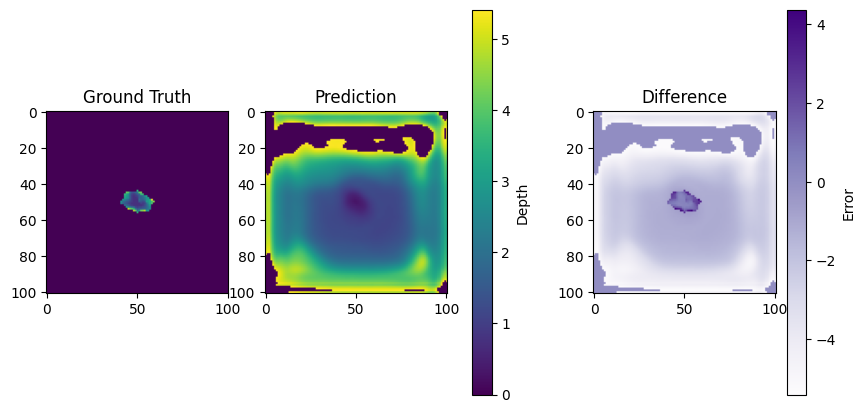

Mean difference: 2.954834461212158


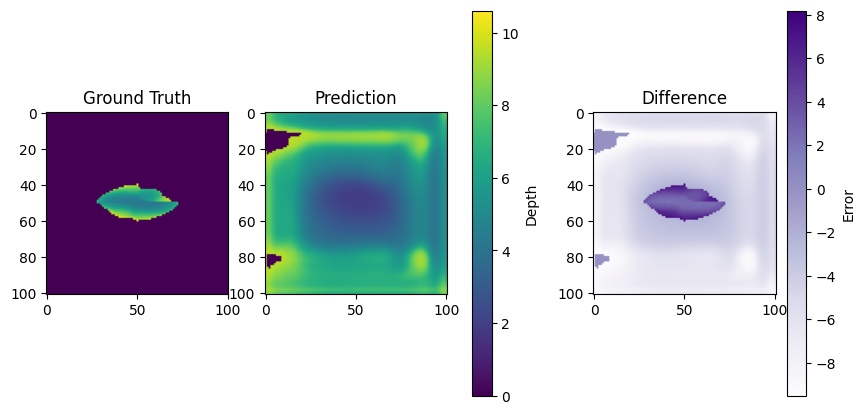

Mean difference: 5.737869739532471


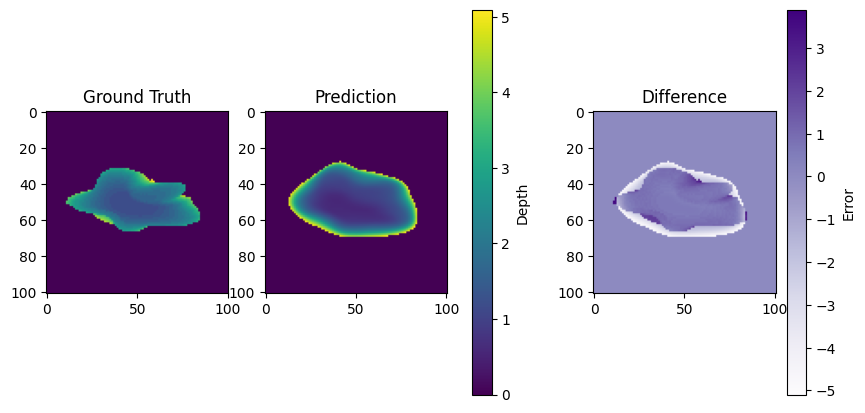

Mean difference: 1.4615968465805054


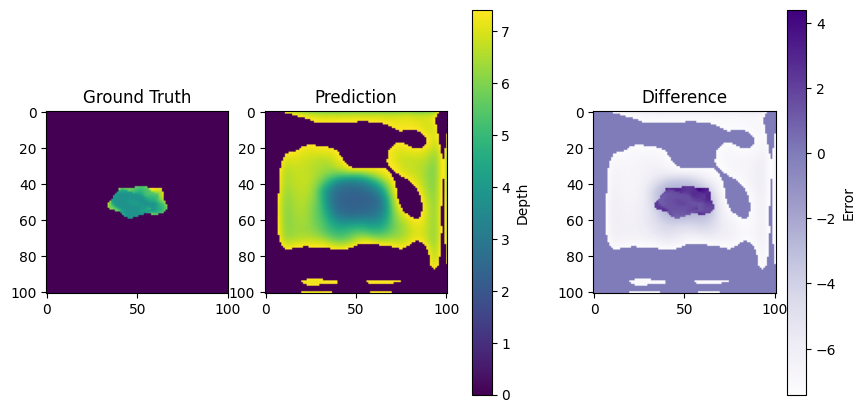

Mean difference: 6.002557277679443


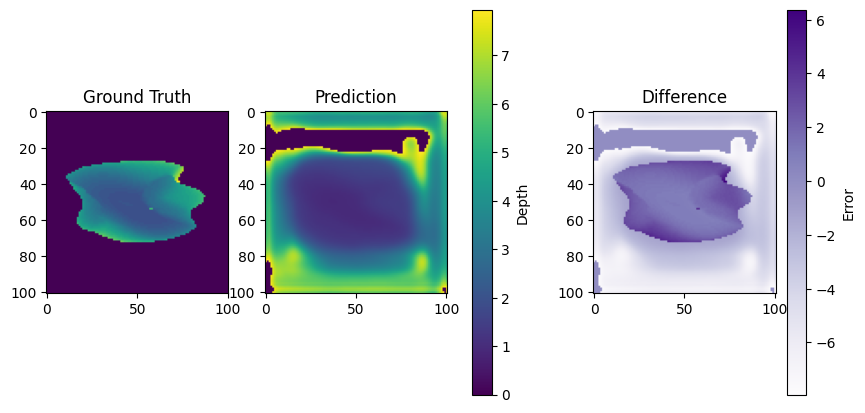

Mean difference: 3.8414981365203857


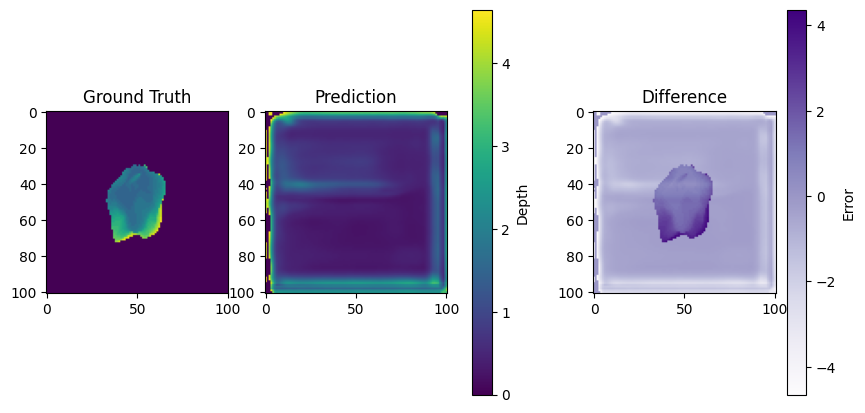

 69%|██████▉   | 9/13 [00:24<00:11,  2.90s/it]

Mean difference: 1.036057472229004


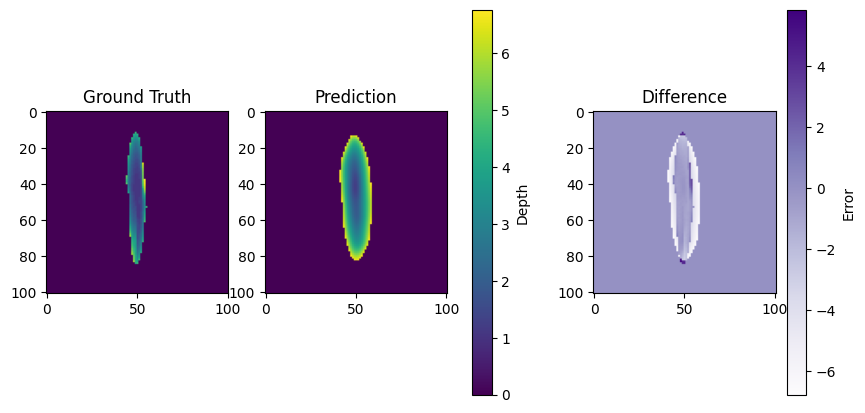

Mean difference: 2.7150022983551025


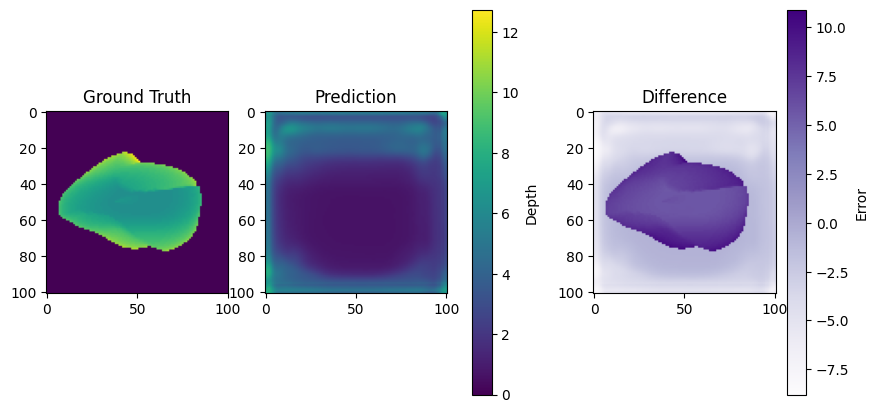

Mean difference: 4.341096878051758


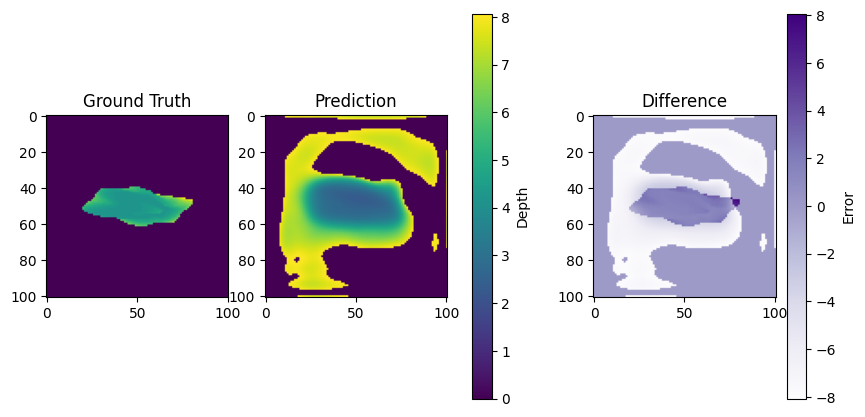

Mean difference: 6.011735439300537


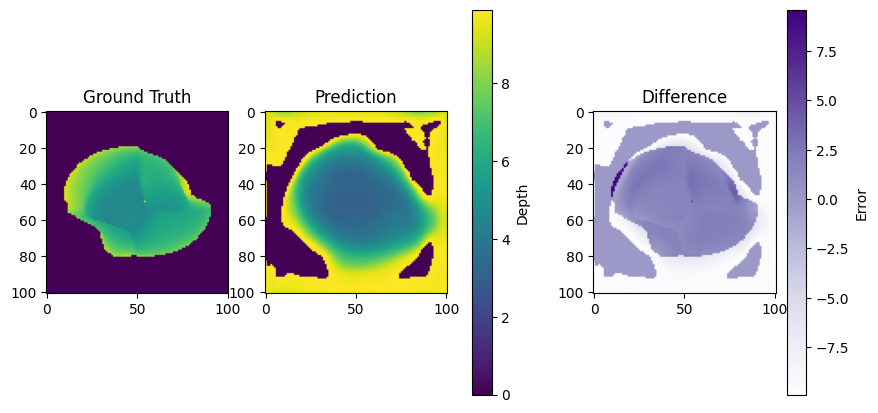

Mean difference: 5.9255290031433105


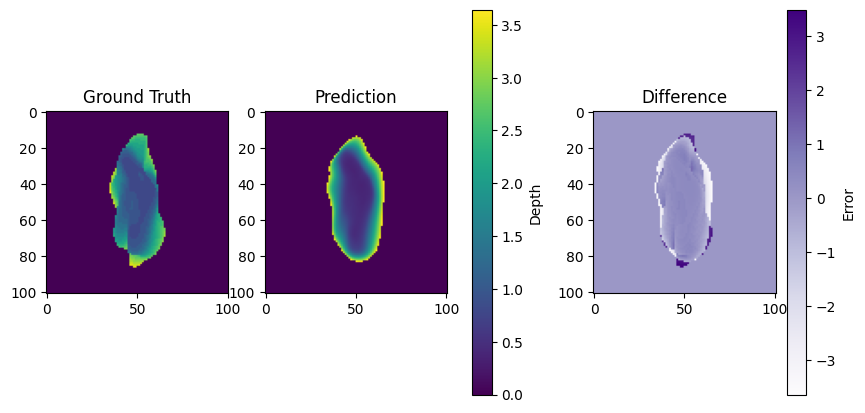

Mean difference: 0.7476921081542969


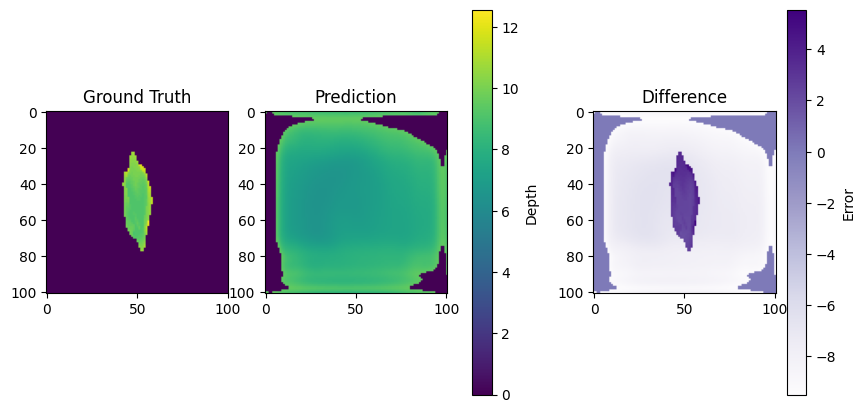

Mean difference: 7.634769916534424


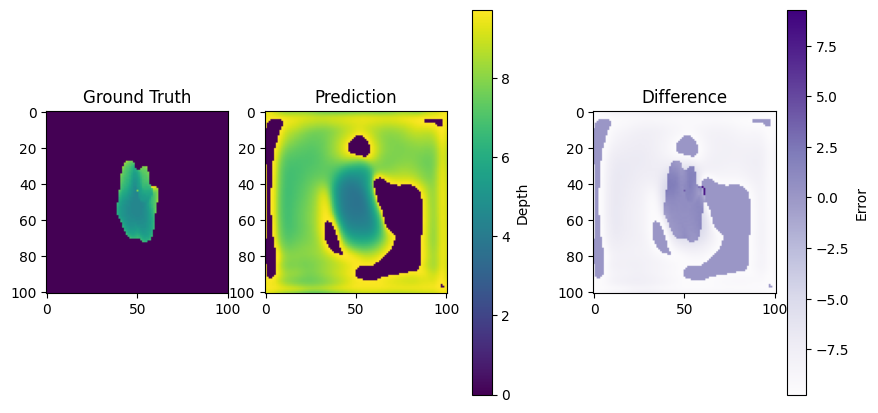

Mean difference: 7.761743545532227


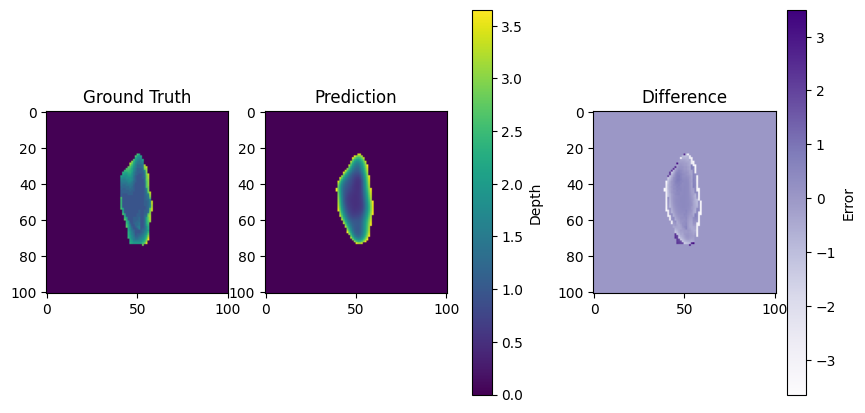

 77%|███████▋  | 10/13 [00:27<00:08,  2.91s/it]

Mean difference: 0.7506878972053528


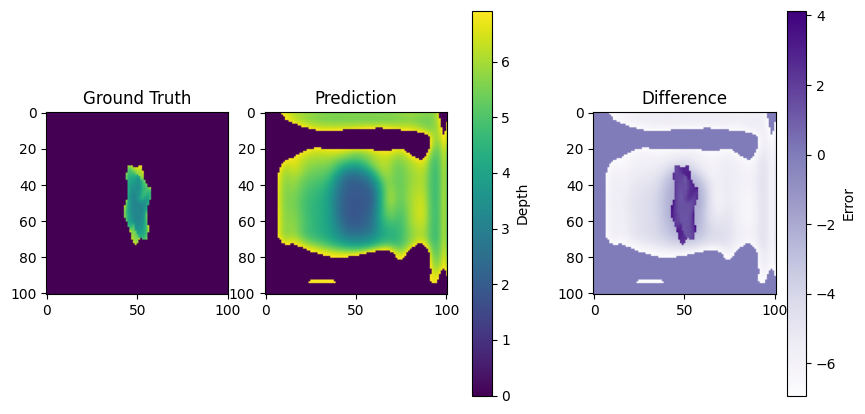

Mean difference: 5.1062188148498535


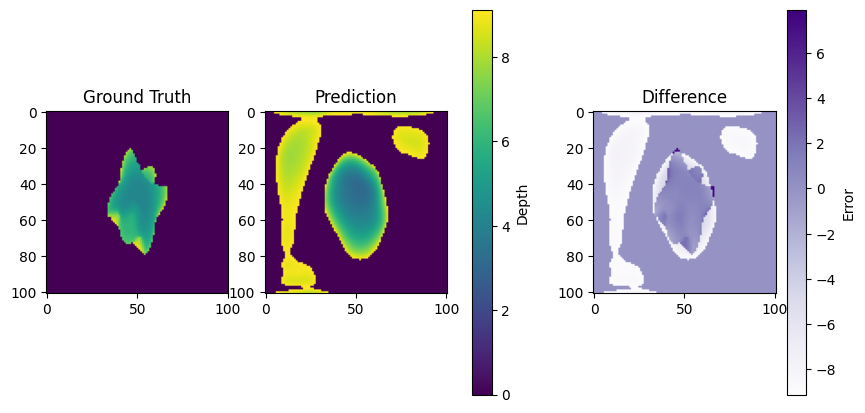

Mean difference: 5.9546942710876465


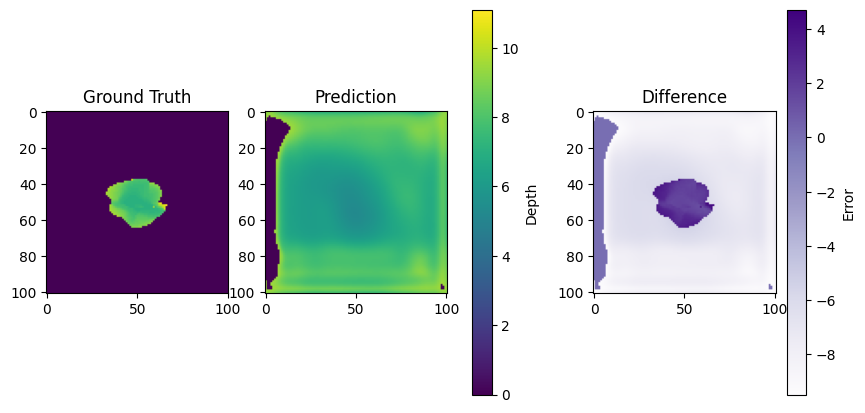

Mean difference: 7.176987648010254


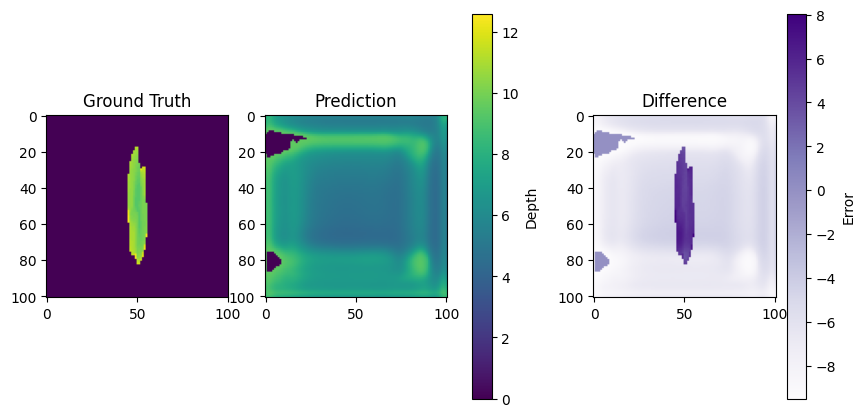

Mean difference: 6.344974994659424


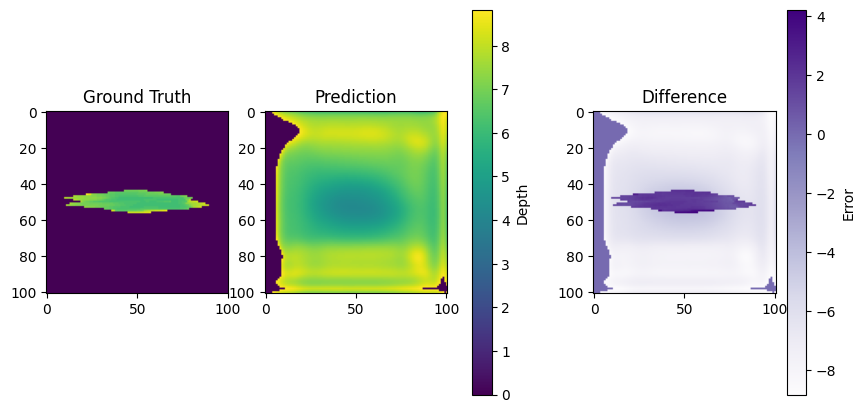

Mean difference: 6.645369529724121


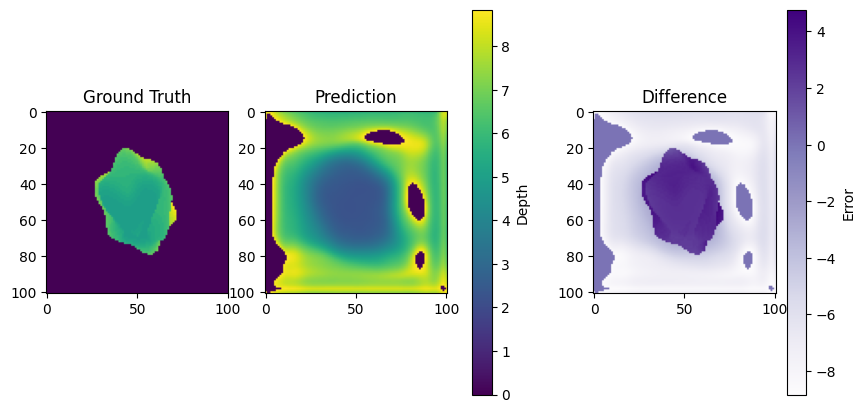

Mean difference: 5.89763879776001


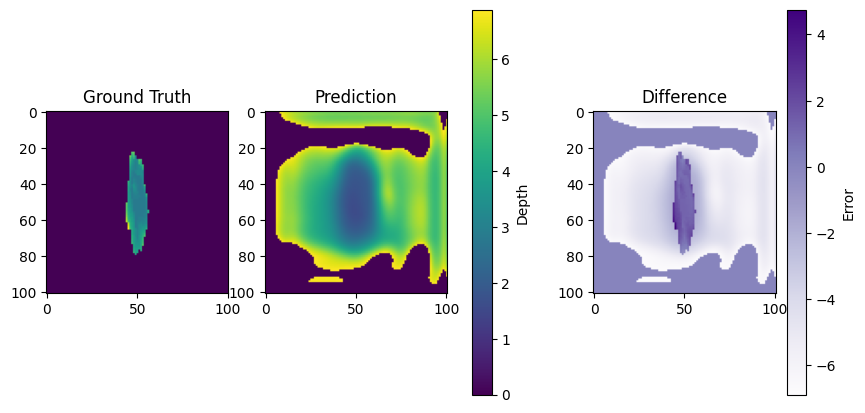

Mean difference: 4.875153541564941


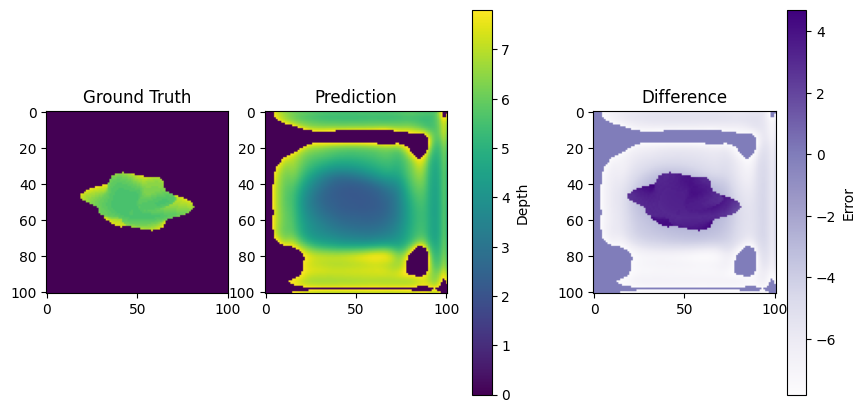

 85%|████████▍ | 11/13 [00:30<00:05,  2.98s/it]

Mean difference: 5.432795524597168


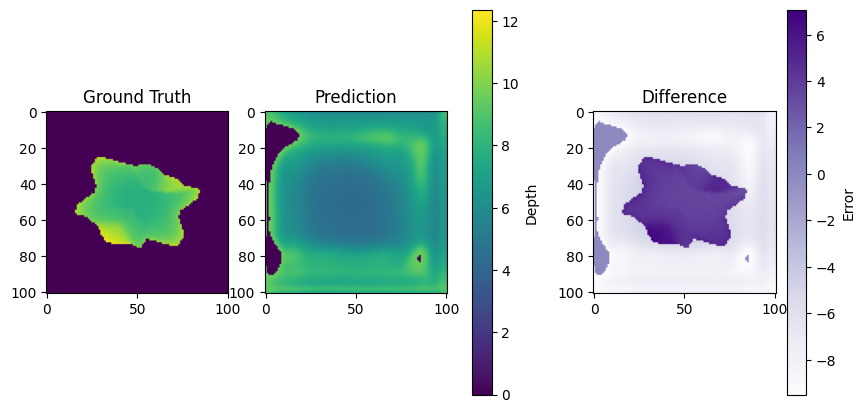

Mean difference: 6.581481456756592


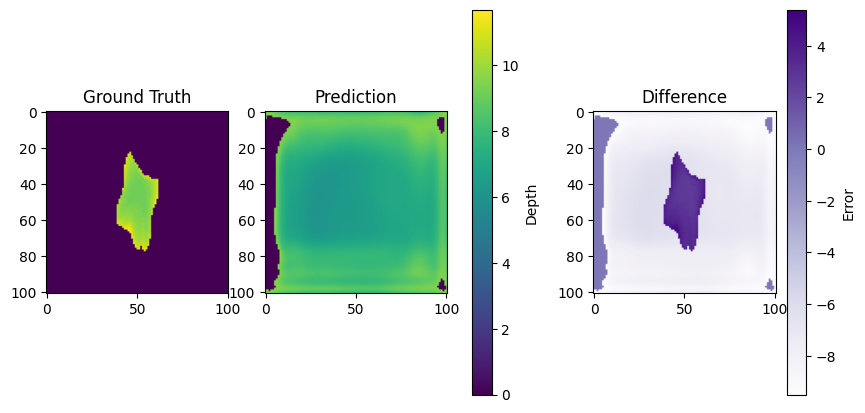

Mean difference: 7.39638614654541


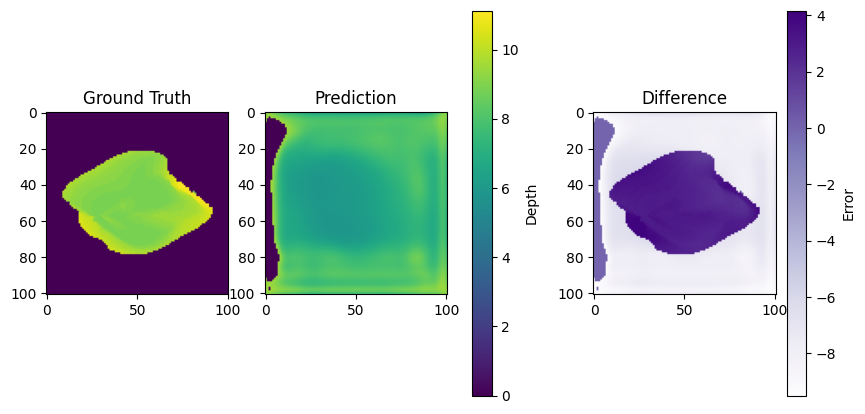

Mean difference: 6.2351460456848145


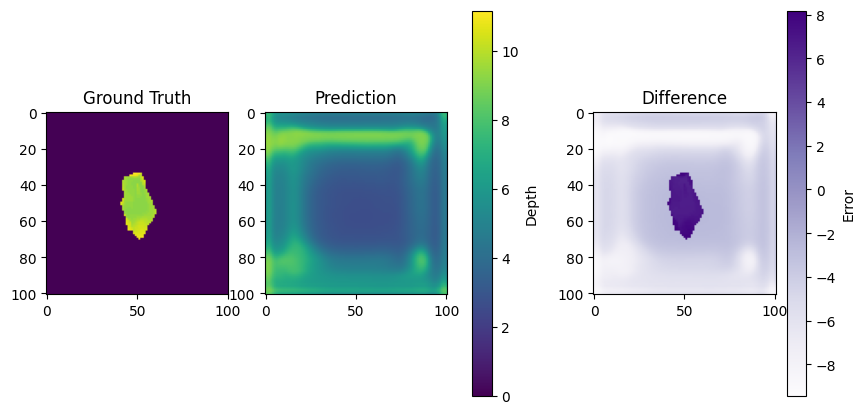

Mean difference: 5.214005470275879


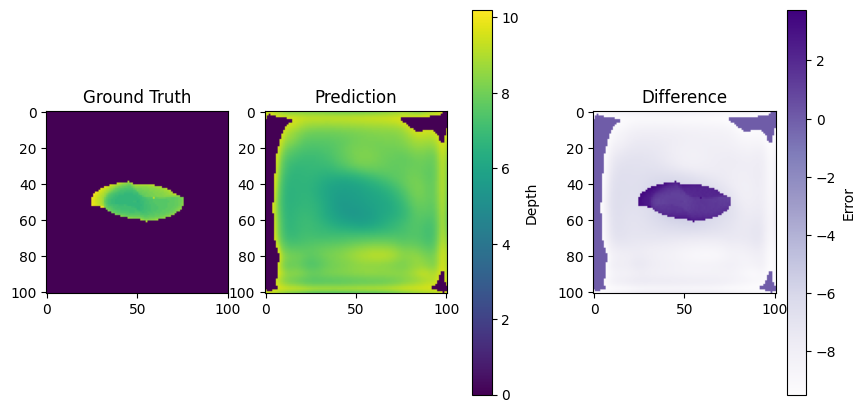

Mean difference: 7.409935474395752


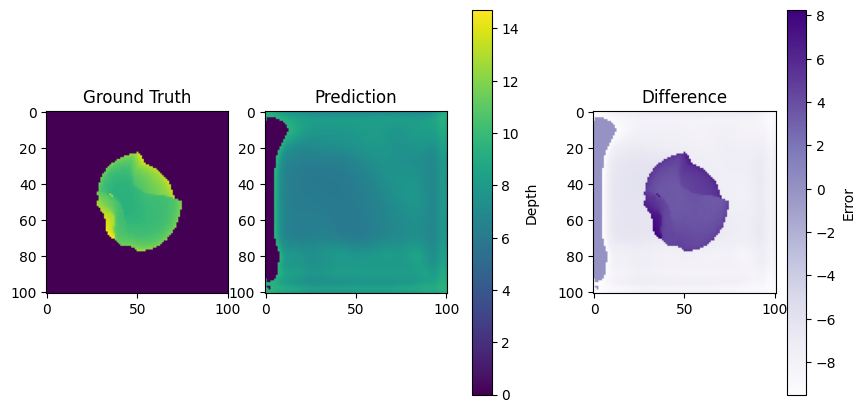

Mean difference: 7.00309419631958


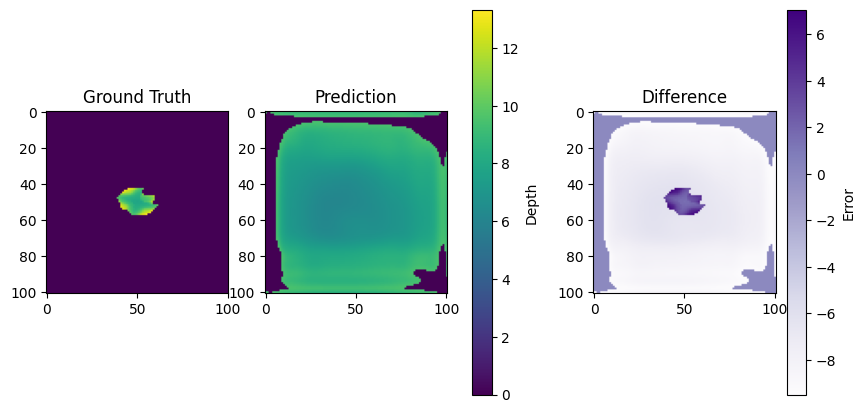

Mean difference: 7.83980131149292


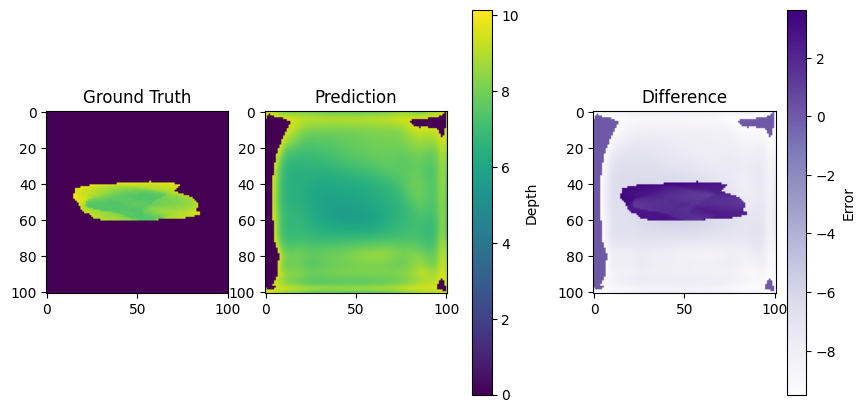

 92%|█████████▏| 12/13 [00:34<00:03,  3.25s/it]

Mean difference: 7.071760654449463


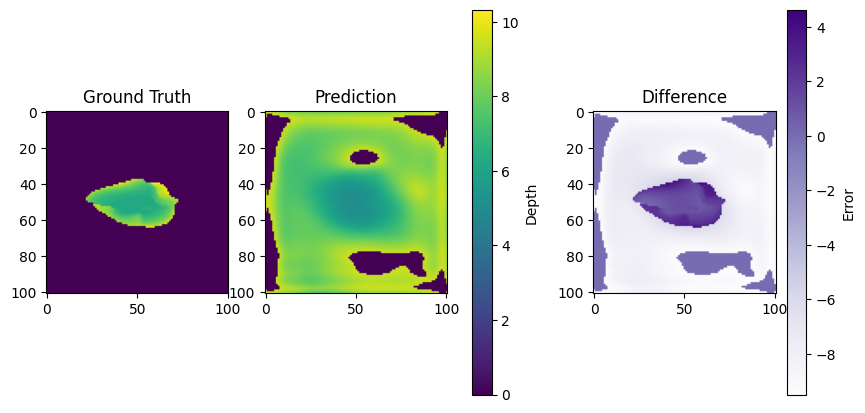

Mean difference: 7.643073558807373


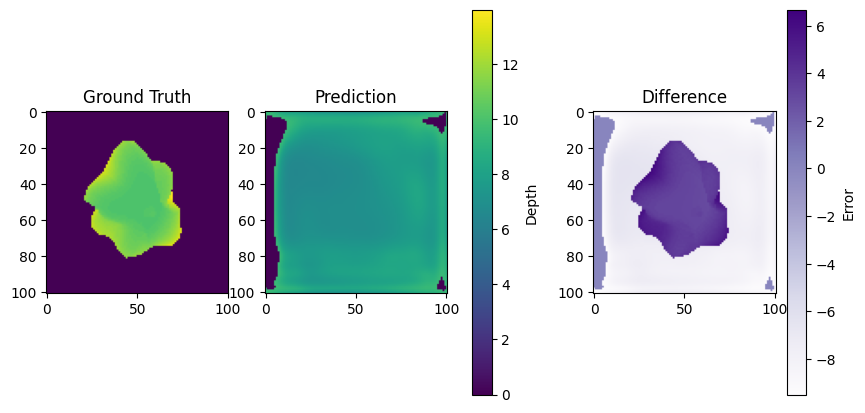

Mean difference: 6.936886787414551


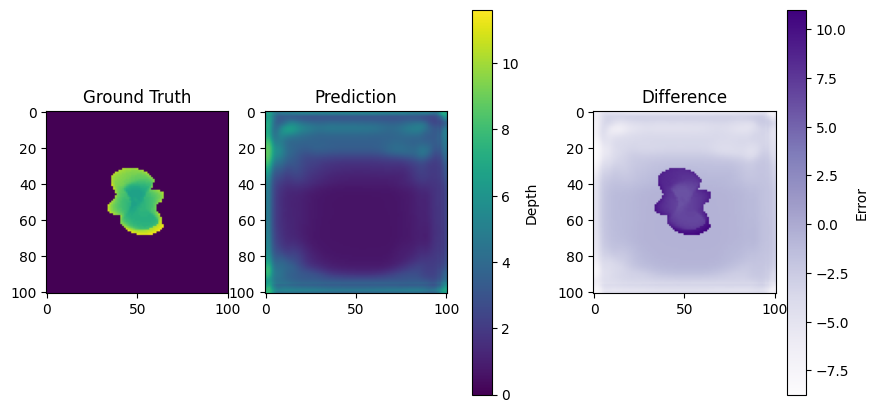

Mean difference: 3.001801013946533


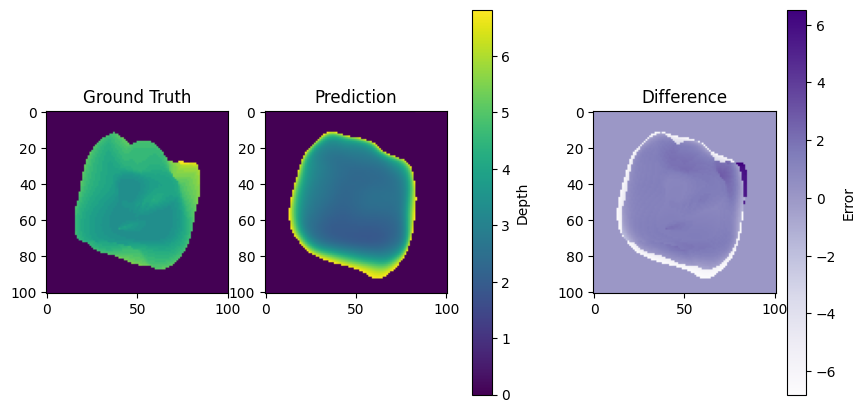

100%|██████████| 13/13 [00:36<00:00,  2.81s/it]

Mean difference: 1.7804296016693115


6.033265491837607

In [32]:
mcx_drop = '/mnt/c/Users/Arthur Zhou/GitHub/gtx_victor/code_tf/model_params/hikaru_dropout_pad10_noTBR/model.keras'
hik_mcx_enoise = '/mnt/c/Users/Arthur Zhou/Documents/model_params/hikaru_dropout_mcx_enoise/model.keras'

model = keras.models.load_model(hik_mcx_enoise, safe_mode=True)
model_vic = keras.models.load_model(mcx_drop, safe_mode=True)
try_pred(model_vic, test_data, draw=True, depth_padding=10.0, device='gpu', batch=8)

In [ ]:
# my model:  2.365541458129883
try_pred(model_vic, test_data, draw=True, depth_padding=10.0, device='gpu', batch=8)
# victor: 


  0%|          | 0/125 [00:00<?, ?it/s]

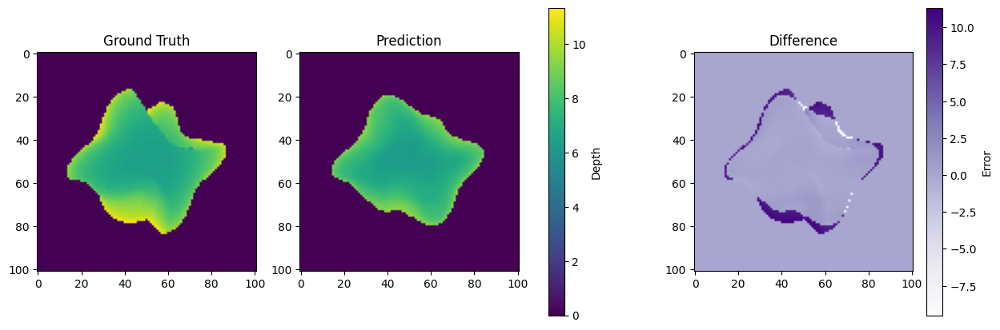

  0%|          | 0/125 [00:00<?, ?it/s]

Mean difference: 1.3766800165176392


In [33]:
model = keras.models.load_model("/content/drive/MyDrive/GTxPython/new_ckpt_unet/hikaru_2d_pad10/model.keras", safe_mode=True)
try_pred(model, test_data, draw=True, depth_padding=10.0, device='gpu', batch=8)

In [15]:
model = keras.models.load_model("/content/drive/MyDrive/GTxPython/new_ckpt_unet/hikaru_2d_pad20/model.keras", safe_mode=True)
try_pred(model, test_data, draw=False, depth_padding=20.0, device='gpu', batch=8)

100%|██████████| 125/125 [00:29<00:00,  4.18it/s]


np.float64(1.0650218867206571)

In [16]:
model = keras.models.load_model("/content/drive/MyDrive/GTxPython/new_ckpt_unet/hikaru_2d_pad10/model.keras", safe_mode=True)
try_pred(model, test_data, draw=False, depth_padding=10.0, device='gpu', batch=8)

100%|██████████| 125/125 [00:27<00:00,  4.60it/s]


np.float64(2.0246821790362897)

## phantom data

In [12]:
def load_phantom_data(path):
    def scale_data(data_dict, params):
        scaled_data_dict = {}
        for key, items in data_dict.items():
            if key != "optical_props" and key != "op":
                scaled_data_dict[key] = items * params[key]
        return scaled_data_dict

    try:
        data = mat73.loadmat(path)
    except:
        data = sio.loadmat(path)
    fluorescence = data['F']
    optical_props = data['OP']
    depth = data['DF']
    concentration_fluor = data['QF']
    reflectance = data['RE']

    output = {
        'fluorescence': fluorescence,
        'reflectance': reflectance,
        'depth': depth,
        'mu_a': optical_props[..., 0],
        'mu_s': optical_props[..., 1],
        'concentration_fluor': concentration_fluor
    }

    return scale_data(output, scale_params)



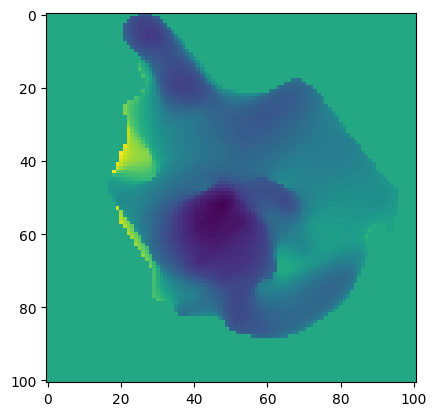

In [37]:
len(phantom_data['depth'])

phantom_data['depth'][0][phantom_data['depth'][0] ==0] = 10.0
plt.imshow(phantom_data['depth'][0])

In [13]:
from skimage.filters import threshold_otsu
def pred_phantom(model, phantom_data, idx, draw=False, depth_padding=10.0, thresh =True):
    fl = phantom_data['fluorescence'][[idx], ...]
    mua = phantom_data['mu_a'][[idx], ...]
    mus = phantom_data['mu_s'][[idx], ...]
    op = np.stack([mua, mus], axis=-1)
    conc_fluor = phantom_data['concentration_fluor'][[idx], ...]
    reflectance = phantom_data['reflectance'][[idx], ...]
    depth = phantom_data['depth'][[idx], ...]
    depth[depth==0] = depth_padding

    input1 = tf.convert_to_tensor(op, dtype=tf.float32)
    input2 = tf.convert_to_tensor(fl, dtype=tf.float32)

    outputs = model([input1, input2], training=False)

    pred_conc = outputs[0].numpy()
    pred_depth = outputs[1].numpy()

    if thresh:
      print("using otsu thresh")
      thresh = threshold_otsu(pred_depth[0])
      mask = pred_depth[0] < thresh
      masked_img = np.where(mask, pred_depth[0], 0)
    else:
      pred_depth_masked = np.where(pred_conc[0] < np.float32(0.1), 0, pred_depth[0])
      #pred_depth_masked = np.where(pred_depth_masked >= np.float32(10.0), 0, pred_depth_masked)
      masked_img = pred_depth_masked
      display(pred_depth_masked.max(), pred_depth_masked.min())



    gt = depth[0].copy()
    #gt[gt==depth_padding]=0
    max_gt = np.max(gt[gt!=depth_padding])
    p = masked_img.copy()

    depth_arr = depth[0].flatten()
    pred_depth_arr = pred_depth[0].flatten()

    min_gt_value = np.min(depth_arr)
    min_gt_px = np.argmin(depth_arr)
    min_pred_value = np.min(pred_depth_arr)
    min_pred_px = np.argmin(pred_depth_arr)
    err_min = np.abs(min_gt_value-min_pred_value)
    print(f"Diff： {err_min}") if draw else None

    draw_pred(gt, masked_img) if draw else None

    return err_min, gt, masked_img


# Run pred in parallel

In [14]:
from pred_util import parallel
#if running parrallel, use the pred_prediction in the pred_util.py

# All model paths and test data paths


In [15]:
mcx_drop = '/mnt/c/Users/Arthur Zhou/GitHub/gtx_victor/code_tf/model_params/hikaru_dropout_pad10_noTBR/model.keras'
mcx_no_drop = '/mnt/c/Users/Arthur Zhou/GitHub/gtx_victor/code_tf/model_params/hikaru_pad10_noTBR/model.keras'
DT = '/mnt/c/Users/Arthur Zhou/GitHub/gtx_victor/code_tf/model_params/hikaru_dropout_2DnoiseDTTBR/model.keras'

hik_DT_minchanges = '/mnt/c/Users/Arthur Zhou/Documents/model_params/hikaru_DT_minimalchanges/model.keras' #rana sent me on teams
hik_rana_aws ='/mnt/c/Users/Arthur Zhou/GitHub/gtx_victor/code_tf/model_params/hikaru_rana_aws/model.keras' # I downlaoded from her AWS job

hik_mcx_enoise = '/mnt/c/Users/Arthur Zhou/Documents/model_params/hikaru_dropout_mcx_enoise/model.keras'

# testing data
drive_path = '/content/drive/MyDrive/GTxPython/data/phantom/phantom_data_corrected.mat'
local_path = '/mnt/c/Users/Arthur Zhou/GitHub/gtx_victor/data/phantom/DL_nImages1.mat'   # Tumor1(?) 2mm
all_tumors = '/mnt/c/Users/Arthur Zhou/GitHub/gtx_victor/data/phantom/all_tumors.mat'
hikaru_test_200 ="/mnt/c/Users/Arthur Zhou/UHN/GTx - DalyShare/ImageData/DL/20221220_AWS/SubmarineTestingDataAll/20250107_20_mandolin_countours_shift_0_10_tumour_1_21_PpIX/DL_nImages200.mat"
local_hikaru_test_200= "/mnt/c/Users/Arthur Zhou/Documents/Data/SubmarineTestingDataAll/20250107_20_mandolin_countours_shift_0_10_tumour_1_21_PpIX/DL_nImages200.mat"


# Experiments

In [16]:
# victor gave me these
phantom_data = load_phantom_data(all_tumors)
phan = load_phantom_data(local_hikaru_test_200)
"""model_mcx_no_drop = keras.models.load_model(mcx_no_drop, safe_mode=True)"""
model_mcx_drop = keras.models.load_model(mcx_drop, safe_mode=True) 
#model_DT = keras.models.load_model(DT, safe_mode=True)

#res_mcx_no_drop_mask = parallel(model_mcx_no_drop, phantom_data, thresh = False)
res_mcx_drop_mask = parallel(model_mcx_drop, phan, thresh = False)
"""res_DT_mask = parallel(model_DT, phantom_data, thresh = False)"""

[Parallel(n_jobs=10)]: Using backend ThreadingBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   5 tasks      | elapsed:    2.3s
[Parallel(n_jobs=10)]: Done  12 tasks      | elapsed:    4.6s
[Parallel(n_jobs=10)]: Done  21 tasks      | elapsed:    7.0s
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    7.1s
[Parallel(n_jobs=10)]: Done  41 tasks      | elapsed:   12.3s
[Parallel(n_jobs=10)]: Done  52 tasks      | elapsed:   15.2s
[Parallel(n_jobs=10)]: Done  65 tasks      | elapsed:   18.8s
[Parallel(n_jobs=10)]: Done  78 tasks      | elapsed:   22.3s
[Parallel(n_jobs=10)]: Done  93 tasks      | elapsed:   26.9s
[Parallel(n_jobs=10)]: Done 108 tasks      | elapsed:   30.6s
[Parallel(n_jobs=10)]: Done 125 tasks      | elapsed:   35.0s
[Parallel(n_jobs=10)]: Done 142 tasks      | elapsed:   39.0s
[Parallel(n_jobs=10)]: Done 161 tasks      | elapsed:   43.7s
[Parallel(n_jobs=10)]: Done 180 tasks      | elapsed:   48.0s
[Parallel(n_jobs=10)]: Done 200 out of 200 | elaps

'res_DT_mask = parallel(model_DT, phantom_data, thresh = False)'

In [ ]:
#loading testing data
phantom_data = load_phantom_data(local_hikaru_test_200)

hikaru_dt = keras.models.load_model(hik_DT_minchanges, safe_mode=True)
hik_dt = keras.models.load_model(hikaru_dt, safe_mode=True)
res_hic = parallel(hik_dt, phantom_data, thresh = False)

[Parallel(n_jobs=10)]: Using backend ThreadingBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   5 tasks      | elapsed:    1.9s
[Parallel(n_jobs=10)]: Done  12 tasks      | elapsed:    3.5s
[Parallel(n_jobs=10)]: Done  21 tasks      | elapsed:    5.1s
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    5.7s
[Parallel(n_jobs=10)]: Done  41 tasks      | elapsed:    8.9s
[Parallel(n_jobs=10)]: Done  52 tasks      | elapsed:   10.7s
[Parallel(n_jobs=10)]: Done  65 tasks      | elapsed:   13.2s
[Parallel(n_jobs=10)]: Done  78 tasks      | elapsed:   15.3s
[Parallel(n_jobs=10)]: Done  93 tasks      | elapsed:   18.7s
[Parallel(n_jobs=10)]: Done 108 tasks      | elapsed:   21.2s
[Parallel(n_jobs=10)]: Done 125 tasks      | elapsed:   24.8s
[Parallel(n_jobs=10)]: Done 142 tasks      | elapsed:   28.4s
[Parallel(n_jobs=10)]: Done 161 tasks      | elapsed:   32.3s
[Parallel(n_jobs=10)]: Done 180 tasks      | elapsed:   35.3s
[Parallel(n_jobs=10)]: Done 200 out of 200 | elaps

In [ ]:
#loading testing data
phantom_data = load_phantom_data(local_hikaru_test_200)

modal_rana = keras.models.load_model(hik_rana_aws, safe_mode=True)
res_rana = parallel(modal_rana, phantom_data, thresh = False)

[Parallel(n_jobs=10)]: Using backend ThreadingBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   5 tasks      | elapsed:    2.7s
[Parallel(n_jobs=10)]: Done  12 tasks      | elapsed:    4.6s
[Parallel(n_jobs=10)]: Done  21 tasks      | elapsed:    6.5s
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    7.2s
[Parallel(n_jobs=10)]: Done  41 tasks      | elapsed:   11.3s
[Parallel(n_jobs=10)]: Done  52 tasks      | elapsed:   14.1s
[Parallel(n_jobs=10)]: Done  65 tasks      | elapsed:   17.2s
[Parallel(n_jobs=10)]: Done  78 tasks      | elapsed:   19.7s
[Parallel(n_jobs=10)]: Done  93 tasks      | elapsed:   23.9s
[Parallel(n_jobs=10)]: Done 108 tasks      | elapsed:   27.2s
[Parallel(n_jobs=10)]: Done 125 tasks      | elapsed:   31.7s
[Parallel(n_jobs=10)]: Done 142 tasks      | elapsed:   36.2s
[Parallel(n_jobs=10)]: Done 161 tasks      | elapsed:   40.1s
[Parallel(n_jobs=10)]: Done 180 tasks      | elapsed:   44.6s
[Parallel(n_jobs=10)]: Done 200 out of 200 | elaps

In [17]:
phantom_data = load_phantom_data(local_hikaru_test_200)

model_mcx_enoise = keras.models.load_model(hik_mcx_enoise, safe_mode=True)
res_enoise = parallel(model_mcx_enoise, phantom_data, thresh = False)

[Parallel(n_jobs=10)]: Using backend ThreadingBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   5 tasks      | elapsed:    2.0s
[Parallel(n_jobs=10)]: Done  12 tasks      | elapsed:    3.8s
[Parallel(n_jobs=10)]: Done  21 tasks      | elapsed:    5.4s
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    6.3s
[Parallel(n_jobs=10)]: Done  41 tasks      | elapsed:   10.2s
[Parallel(n_jobs=10)]: Done  52 tasks      | elapsed:   12.7s
[Parallel(n_jobs=10)]: Done  65 tasks      | elapsed:   15.8s
[Parallel(n_jobs=10)]: Done  78 tasks      | elapsed:   18.2s
[Parallel(n_jobs=10)]: Done  93 tasks      | elapsed:   22.6s
[Parallel(n_jobs=10)]: Done 108 tasks      | elapsed:   25.6s
[Parallel(n_jobs=10)]: Done 125 tasks      | elapsed:   30.1s
[Parallel(n_jobs=10)]: Done 142 tasks      | elapsed:   34.4s
[Parallel(n_jobs=10)]: Done 161 tasks      | elapsed:   39.0s
[Parallel(n_jobs=10)]: Done 180 tasks      | elapsed:   43.0s
[Parallel(n_jobs=10)]: Done 200 out of 200 | elaps

# plotting

### Loss

In [19]:
loss_me = "/".join(hik_mcx_enoise.split('/')[:-1]) + "/loss.log"
loss_victor_drop = "/".join(mcx_drop.split('/')[:-1]) + "/loss.log"

import pandas as pd
df_me = pd.read_csv(loss_me, header=None)
df_victor = pd.read_csv(loss_victor_drop, header=None)

1.726448

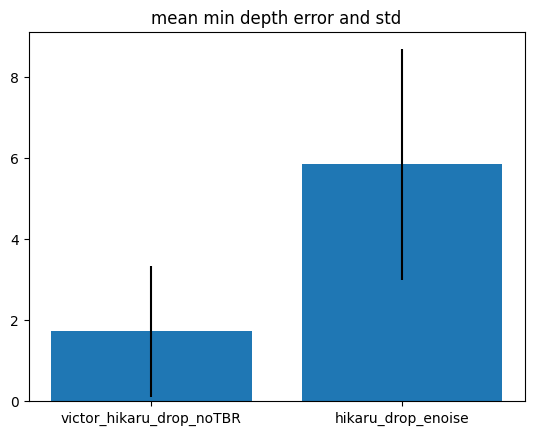

In [21]:
victor_hikaru_drop_noTBR_mean = np.mean([i[0] for i in res_mcx_drop_mask])
victor_hikaru_drop_noTBR_std = np.std([i[0] for i in res_mcx_drop_mask])

hikaru_drop = np.mean([i[0] for i in res_enoise])
hikaru_drop_std = np.std([i[0] for i in res_enoise])

plt.bar(height = [victor_hikaru_drop_noTBR_mean, hikaru_drop], x = ['victor_hikaru_drop_noTBR', 'hikaru_drop_enoise'], yerr = [victor_hikaru_drop_noTBR_std, hikaru_drop_std]) 
plt.title("mean min depth error and std")

hikaru_drop
victor_hikaru_drop_noTBR_mean

Text(0.5, 1.0, "Victor's model loss dropout+mcx vs me train")

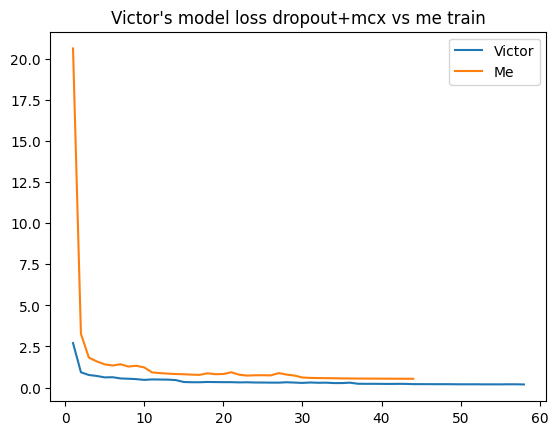

In [22]:
x = df_victor[2][1:].index.to_numpy()
y = df_victor[2][1:].to_numpy()

x = [float(i) for i in x]
y = [float(i) for i in y]

plt.plot(x,y)


a = df_me[2][1:].index.to_numpy()
b = df_me[2][1:].to_numpy()

a = [float(i) for i in a]
b = [float(i) for i in b]

plt.plot(a,b)
plt.legend(['Victor', 'Me'])
plt.title("Victor's model loss dropout+mcx vs me train")

In [26]:
def plot_F(pred):
    fig, ax = plt.subplots(200,2, figsize=(28, 800))
    for idx, i  in enumerate(pred):
        gt_F = i[4]
        pred_F = i[3]
        v_min = min(np.min(gt_F), np.min(pred_F))
        v_max = max(np.max(gt_F), np.max(pred_F))
        im0 = ax[idx, 0].imshow(gt_F, cmap='viridis', vmin=v_min, vmax=v_max)
        ax[idx, 0].set_title('Ground Truth Fluorescence')
        ax[idx, 1].imshow(pred_F, cmap='viridis', vmin=v_min, vmax=v_max)
        ax[idx, 1].set_title('Predicted Fluorescence')
        cbar = fig.colorbar(im0, ax=ax[idx, :], orientation='vertical')
        cbar.set_label('Fluorescence Intensity')
    plt.show()


plot_F(res_enoise)

In [23]:
def plot_multi(res_mcx_no_drop =None, res_mcx_drop =None, res_DT =None, phantom_data =None, mask_type = "otsu"):
  if res_mcx_no_drop is None and res_mcx_drop is None and res_DT is None and phantom_data is None:
    print("Please provide at least one required arguments.")
    return


  fig, ax = plt.subplots(200, 2, figsize=(12*2,200*4))
  for idx, (i) in enumerate((res_mcx_no_drop)):
      gt_depth = i[1]
      pred_depth_i = i[2]
      """     pred_depth_j = j[2]
      pred_depth_k = k[2]"""
      v_min = min(np.min(gt_depth), np.min([pred_depth_i]))
      v_max = max(np.max(gt_depth), np.max([pred_depth_i]))

      im0 = ax[idx, 0].imshow(gt_depth, cmap='viridis', vmin=v_min, vmax=v_max)
      ax[idx, 0].set_title('Ground Truth')
      ax[idx, 1].imshow(pred_depth_i, cmap='viridis', vmin=v_min, vmax=v_max)
      ax[idx, 1].set_title('DT hikaru')
      """ax[idx, 2].imshow(pred_depth_j, cmap='viridis', vmin=v_min, vmax=v_max)
      ax[idx, 2].set_title('MCX Dropout')
      ax[idx, 3].imshow(pred_depth_k, cmap='viridis', vmin=v_min, vmax=v_max)
      ax[idx, 3].set_title('DT')"""
      cbar = fig.colorbar(im0, ax=ax[idx, :], orientation='vertical')
      cbar.set_label('Depth')

  fig.suptitle(f'Phantom Data Predictions mask with = {mask_type}')
  plt.show()

"""plot_multi(res_mcx_no_drop, res_mcx_drop, res_DT, phantom_data)
plot_multi(res_mcx_no_drop_mask, res_mcx_drop_mask, res_DT_mask, phantom_data, mask_type ="F conc")
"""

plot_multi(res_mcx_no_drop = res_enoise, phantom_data = phantom_data, mask_type = "f")



In [ ]:
plot_multi(res_mcx_no_drop = res_enoise, phantom_data = phantom_data, mask_type = "f")

np.float32(9.798209)

np.float32(0.0)

Diff： 1.3060505390167236


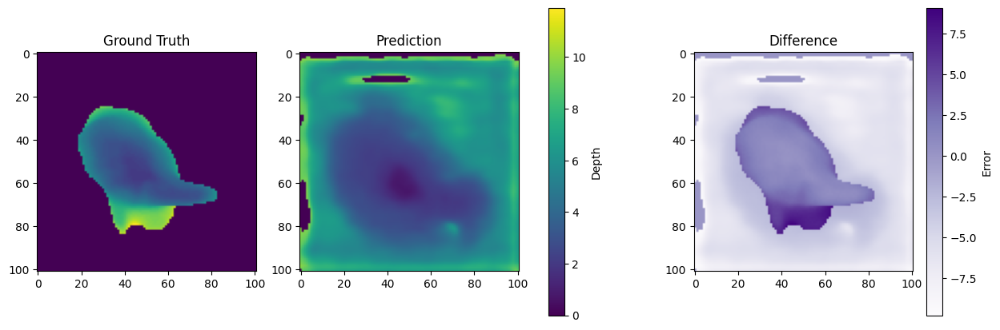

np.float32(1.3060505)

In [ ]:
def try_pred_on_phantom(model, phantom_data, draw=False, depth_padding=10.0, mm_pred=None):
    err_min_sum = 0
    err_min_count = 0
    for i in range(len(phantom_data['fluorescence'])):
        err_min = pred_phantom_1(model, phantom_data, i, draw=draw, depth_padding=depth_padding, thresh = False)
        err_min_sum += err_min
        err_min_count += 1

    return err_min_sum / err_min_count

mcx_drop = '/mnt/c/Users/Arthur Zhou/GitHub/gtx_victor/code_tf/model_params/hikaru_dropout_pad10_noTBR/model.keras'
mcx_no_drop = '/mnt/c/Users/Arthur Zhou/GitHub/gtx_victor/code_tf/model_params/hikaru_pad10_noTBR/model.keras'

model = keras.models.load_model(mcx_no_drop, safe_mode=True)
try_pred_on_phantom(model, phantom_data, draw=True, depth_padding=10.0, mm_pred=None)
